In [2]:
#### 1.Loading_data_for_gene_set_analysis.R
# 1)Read COAD expression data
### This RNA data was the same in RNA omic analysis data
TCGA_COAD_RNAseqV2_normalized_log2_dataset <- readRDS("/data8t_4/JH/MyJobs/Read_dataset/TCGA_Hub/TCGA_Colon_Cancer_COAD/TCGA_COAD_RNAseqV2_normalized_log2_dataset.rds")
COAD.HiSeqV2.log2 <- TCGA_COAD_RNAseqV2_normalized_log2_dataset$COAD.HiSeqV2.log2
COAD.pheno <- TCGA_COAD_RNAseqV2_normalized_log2_dataset$COAD.pheno
#TCGA_COAD_RNAseqV2_normalized_log2_dataset$COAD.HiSeqV2.metadata
# 2)Read cluster resaults
Cluster.20200201.V7.Tumor <- readRDS("/data8t_4/JH/MyJobs/NormalCancer_TCGA_V2/Cluster.20200201.V7.Tumor.rds")
cutree.res <- Cluster.20200201.V7.Tumor$cutree.res
dynamicColors <- Cluster.20200201.V7.Tumor$dynamicColors
Cluster.df <- cbind(cutree.res,dynamicColors) 
Cluster.df <- as.data.frame(Cluster.df)
Cluster.df$rownames <- rownames(Cluster.df)
hclust.Res <- Cluster.20200201.V7.Tumor$hclust.Res
# 3)Read GeneSetCollection object gmt download from MSigDB
MSigDB_gmt_V7_symbols_dataset <- readRDS("/data8t_4/JH/MyJobs/Read_dataset/MSigDB/MSigDB_gmt_V7_symbols_dataset.rds")
MSigDB_gmt_V7_symbols <- MSigDB_gmt_V7_symbols_dataset$symbols.gmt.list
MSigDB_V7_metadata <- MSigDB_gmt_V7_symbols_dataset$MSigDB_V7_metadata
c2.all.v7.0.symbols.gmt <- MSigDB_gmt_V7_symbols$c2.all.v7.0.symbols.gmt
#c2.all.v7.0.symbols.gmt
### description files in 
# https://www.gsea-msigdb.org/gsea/msigdb/genesets.jsp
# description(c2.all.v7.0.symbols.gmt[[1]])


In [3]:
#### 2.COAD_GSVA_MSigDB_analysis.R
## 1)Construct COAD Expression set object
library(Biobase)
all(rownames(Cluster.df)==colnames(COAD.HiSeqV2.log2))
## Subset the expression data to Cluster.df
expr.sub <- as.matrix(COAD.HiSeqV2.log2[,colnames(COAD.HiSeqV2.log2) %in% rownames(Cluster.df)])
Cluster.df.sub <- Cluster.df[colnames(expr.sub),1:2]
Cluster.df.sub <- new("AnnotatedDataFrame",
                      data=Cluster.df.sub)
all(rownames(Cluster.df.sub)==colnames(expr.sub))
COAD.ExpressionSet <- ExpressionSet(assayData=expr.sub,phenoData=Cluster.df.sub)
### 2)GSVA
## Load data I have done
COAD.h.all.v7.0 <- readRDS("/data8t_4/JH/MyJobs/COAD_NormalCancer_Project/2.Molecular_dataset/2.Gene_set_analysis/COAD.GSVA.h.all.v7.0.rds")
COAD.c1.all.v7.0 <- readRDS("/data8t_4/JH/MyJobs/COAD_NormalCancer_Project/2.Molecular_dataset/2.Gene_set_analysis/COAD.GSVA.c1.all.v7.0.rds")
COAD.c2.all.v7.0 <- readRDS("/data8t_4/JH/MyJobs/COAD_NormalCancer_Project/2.Molecular_dataset/2.Gene_set_analysis/COAD.GSVA.c2.all.v7.0.rds")
COAD.c3.all.v7.0 <- readRDS("/data8t_4/JH/MyJobs/COAD_NormalCancer_Project/2.Molecular_dataset/2.Gene_set_analysis/COAD.GSVA.c3.all.v7.0.rds")
COAD.c4.all.v7.0 <- readRDS("/data8t_4/JH/MyJobs/COAD_NormalCancer_Project/2.Molecular_dataset/2.Gene_set_analysis/COAD.GSVA.c4.all.v7.0.rds")
COAD.c5.all.v7.0 <- readRDS("/data8t_4/JH/MyJobs/COAD_NormalCancer_Project/2.Molecular_dataset/2.Gene_set_analysis/COAD.GSVA.c5.all.v7.0.rds")
COAD.c6.all.v7.0 <- readRDS("/data8t_4/JH/MyJobs/COAD_NormalCancer_Project/2.Molecular_dataset/2.Gene_set_analysis/COAD.GSVA.c6.all.v7.0.rds")
COAD.c7.all.v7.0 <- readRDS("/data8t_4/JH/MyJobs/COAD_NormalCancer_Project/2.Molecular_dataset/2.Gene_set_analysis/COAD.GSVA.c7.all.v7.0.rds")


Warning message in rownames(Cluster.df) == colnames(COAD.HiSeqV2.log2):
“longer object length is not a multiple of shorter object length”

[1] FALSE

[1] TRUE

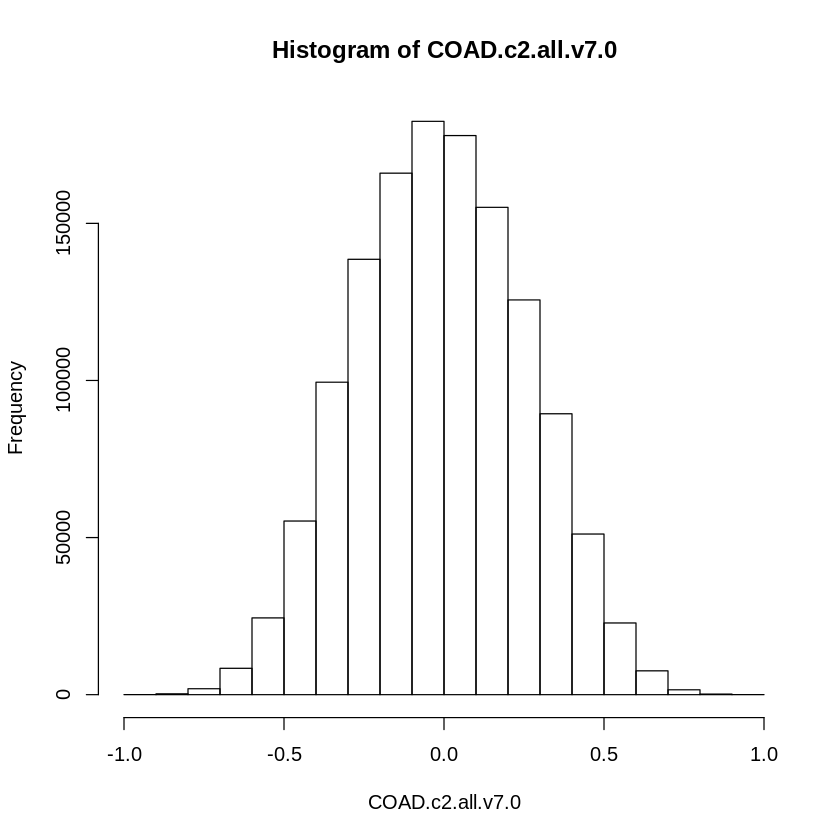

In [4]:
#### 3.COAD.Significant_MSigDB_analysis.R
### 1.Exame distribution of ssGSEA score
hist(COAD.c2.all.v7.0)
### 2.Using limma to find significant pathway in each groups
library(Biobase)
## 1) Build an ExpressionSet
COAD.h.all.Set <- ExpressionSet(assayData=COAD.h.all.v7.0,phenoData=Cluster.df.sub)
COAD.c1.all.Set <- ExpressionSet(assayData=COAD.c1.all.v7.0,phenoData=Cluster.df.sub)
COAD.c2.all.Set <- ExpressionSet(assayData=COAD.c2.all.v7.0,phenoData=Cluster.df.sub)
COAD.c3.all.Set <- ExpressionSet(assayData=COAD.c3.all.v7.0,phenoData=Cluster.df.sub)
COAD.c4.all.Set <- ExpressionSet(assayData=COAD.c4.all.v7.0,phenoData=Cluster.df.sub)
COAD.c5.all.Set <- ExpressionSet(assayData=COAD.c5.all.v7.0,phenoData=Cluster.df.sub)
COAD.c6.all.Set <- ExpressionSet(assayData=COAD.c6.all.v7.0,phenoData=Cluster.df.sub)
COAD.c7.all.Set <- ExpressionSet(assayData=COAD.c7.all.v7.0,phenoData=Cluster.df.sub)
## Several Groups experiment design
#COAD.c2.all.Set@phenoData@data
f <- factor(Cluster.df.sub@data$dynamicColors, levels=c("blue","brown","turquoise","yellow"))
design <- model.matrix(~0+f)
colnames(design) <- c("blue","brown","turquoise","yellow")

Coefficients not estimable: yellow 


Warning message:
“Partial NA coefficients for 50 probe(s)”

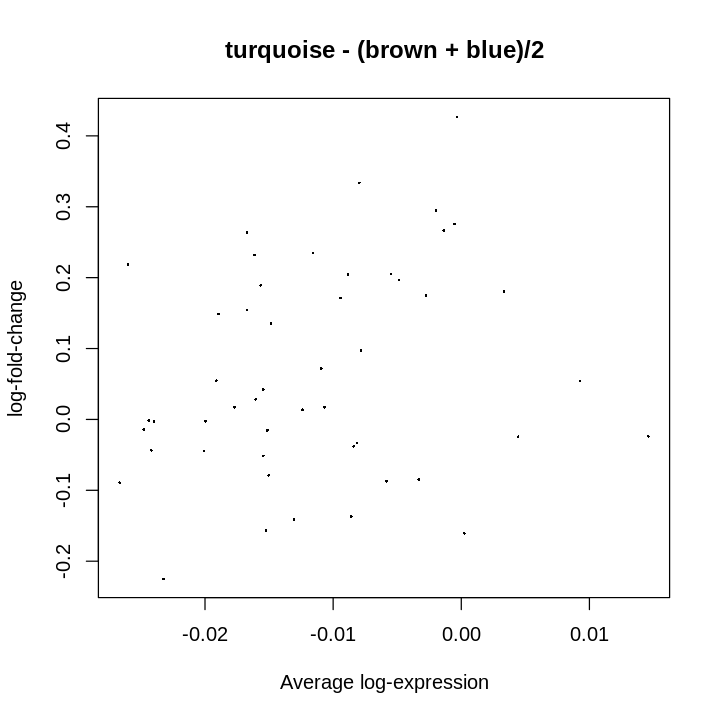

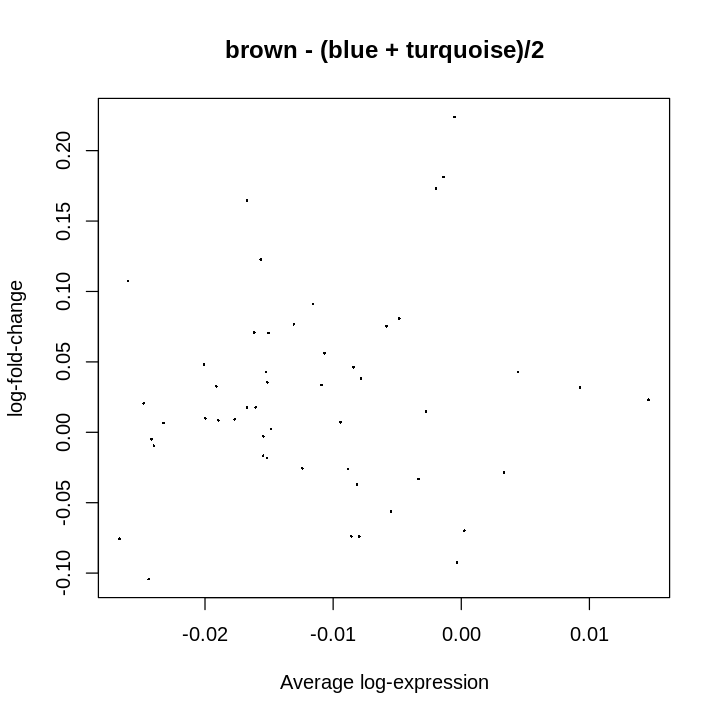

       blue - (brown + turquoise)/2 brown - (blue + turquoise)/2
Down                             24                            0
NotSig                           20                           45
Up                                6                            5
       turquoise - (brown + blue)/2
Down                              7
NotSig                           21
Up                               22

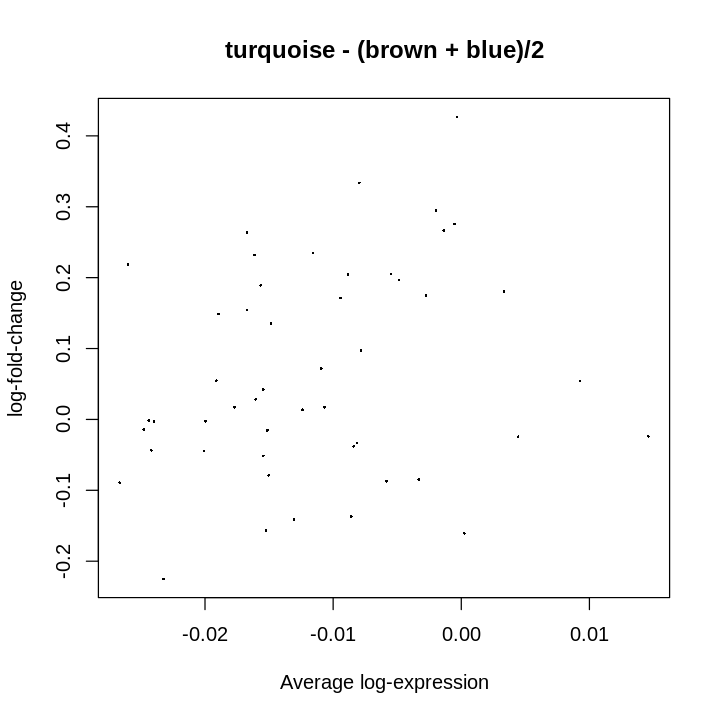

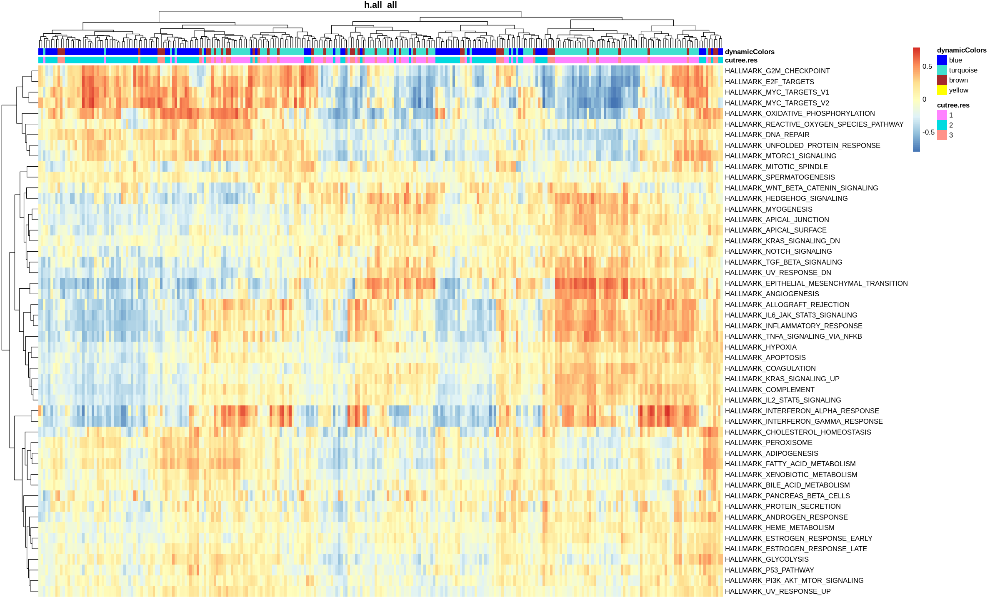

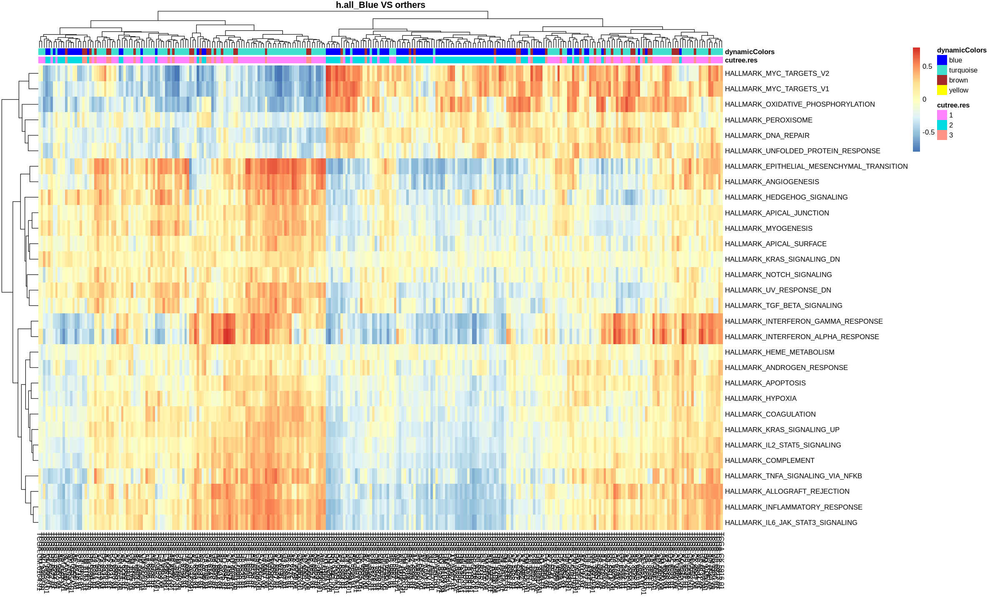

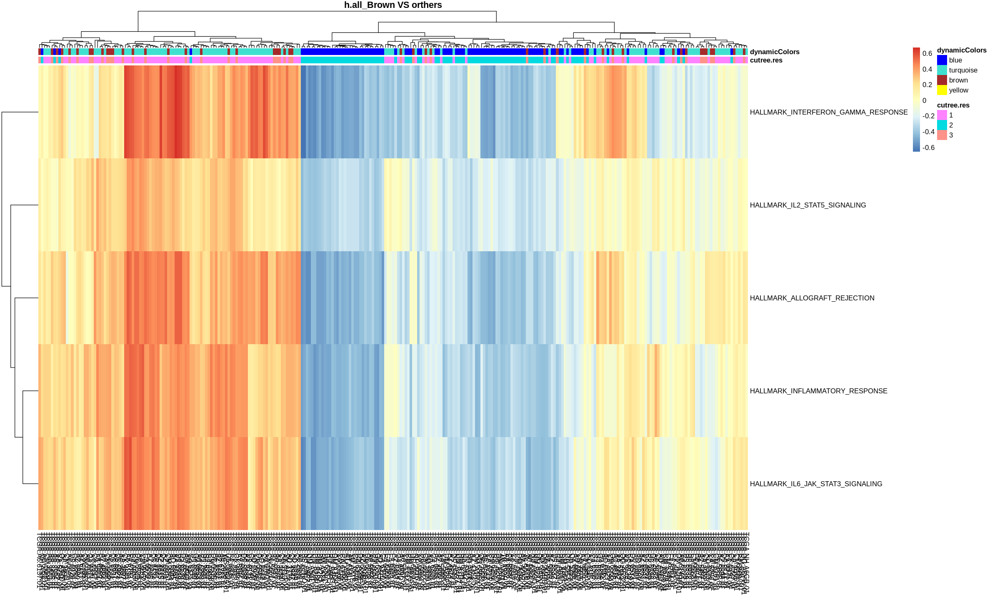

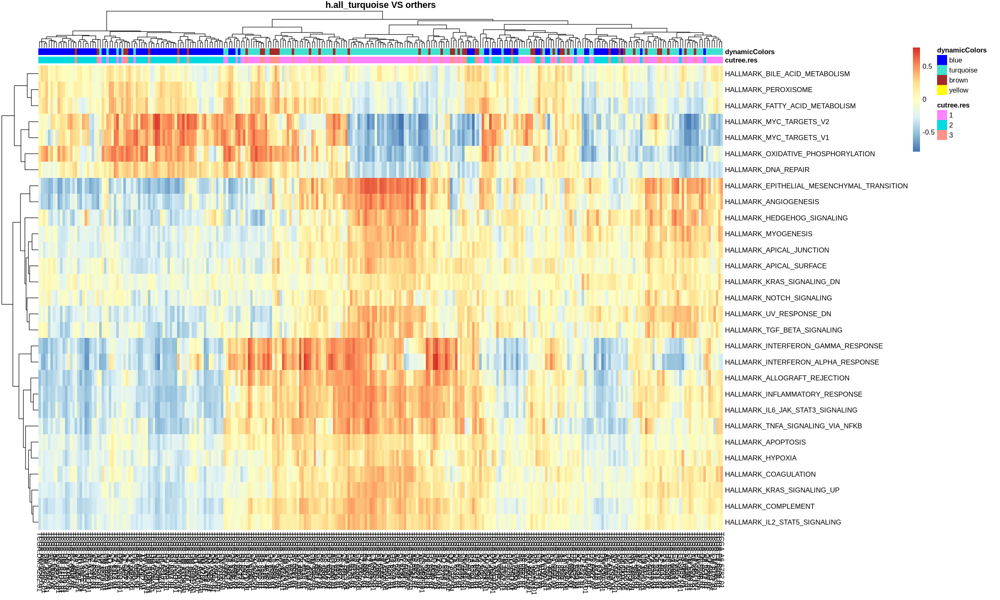

In [11]:
## 2) Significant pathway analysis
###################### COAD.h.all.Set ##################
library(limma)
fit.h <- lmFit(COAD.h.all.Set, design)
contrast.matrix <- makeContrasts(blue-(brown+turquoise)/2, 
                                 brown-(blue+turquoise)/2,
                                 turquoise-(brown+blue)/2,
                                 levels=design)
fit.h.2 <- contrasts.fit(fit.h, contrast.matrix)
fit.h.2 <- eBayes(fit.h.2)
options(repr.plot.width=6, repr.plot.height=6)
plotMD(fit.h.2)
plotMD(fit.h.2, column = 2)
plotMD(fit.h.2, column = 3)
## Find Top significant genesets
## Cut off
adjPvalueCutoff <- 0.01
number = 50
## 
dt <- decideTests(fit.h.2, p.value = adjPvalueCutoff )
summary(dt)
DEgeneSets.blue.h <- topTable(fit.h.2, coef="blue - (brown + turquoise)/2", number=number,
                              p.value=adjPvalueCutoff,adjust="BH")
DEgeneSets.brown.h <- topTable(fit.h.2, coef="brown - (blue + turquoise)/2", number=number,
                               p.value=adjPvalueCutoff,adjust="BH")
DEgeneSets.turquoise.h <- topTable(fit.h.2, coef="turquoise - (brown + blue)/2", number=number,
                                   p.value=adjPvalueCutoff,adjust="BH")
## Ploting
library(pheatmap)
ann_colors = list(dynamicColors = c(blue = "blue",turquoise = "turquoise", 
                                    brown = "brown", yellow = "yellow"))
options(repr.plot.width=20, repr.plot.height=12)
pheatmap::pheatmap(COAD.h.all.Set,annotation_col = pData(COAD.h.all.Set),
                   main = "h.all_all",show_colnames = F,annotation_colors = ann_colors)
pheatmap::pheatmap(COAD.h.all.Set[rownames(DEgeneSets.blue.h),],annotation_col = pData(COAD.h.all.Set),
                   main = "h.all_Blue VS orthers",annotation_colors = ann_colors)
pheatmap::pheatmap(COAD.h.all.Set[rownames(DEgeneSets.brown.h),],annotation_col = pData(COAD.h.all.Set),
                   main = "h.all_Brown VS orthers",annotation_colors = ann_colors)
pheatmap::pheatmap(COAD.h.all.Set[rownames(DEgeneSets.turquoise.h),],annotation_col = pData(COAD.h.all.Set),
                   main = "h.all_turquoise VS orthers",annotation_colors = ann_colors)

Coefficients not estimable: yellow 


Warning message:
“Partial NA coefficients for 266 probe(s)”

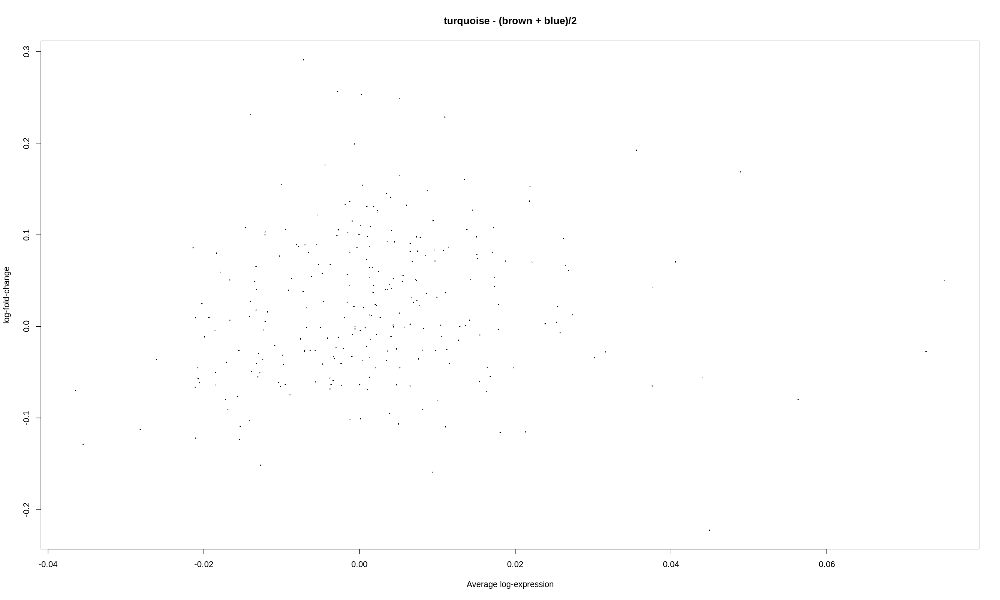

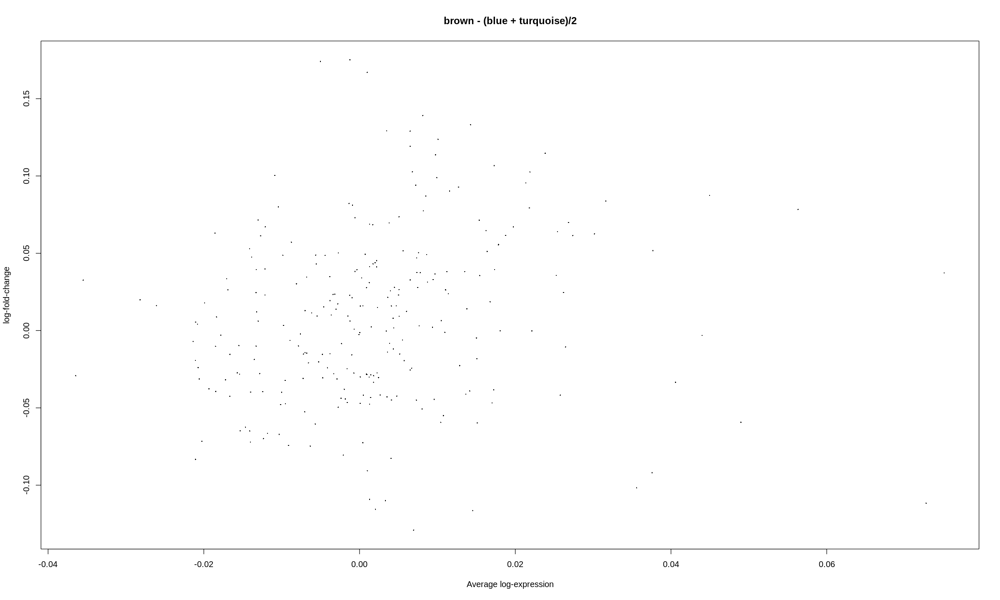

       blue - (brown + turquoise)/2 brown - (blue + turquoise)/2
Down                             51                            0
NotSig                          203                          265
Up                               12                            1
       turquoise - (brown + blue)/2
Down                              9
NotSig                          224
Up                               33

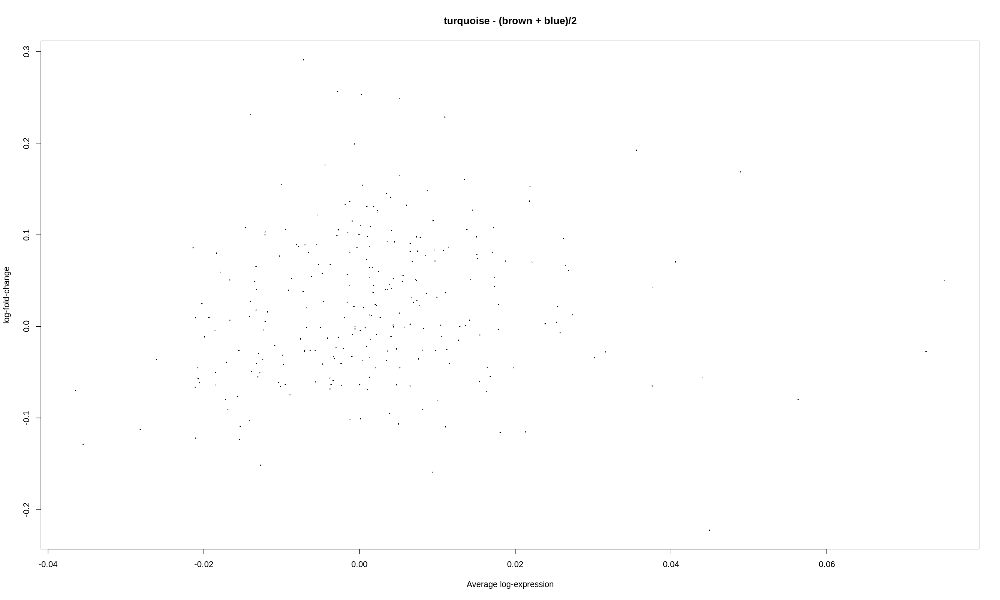

ERROR: Error in hclust(d, method = method): must have n >= 2 objects to cluster


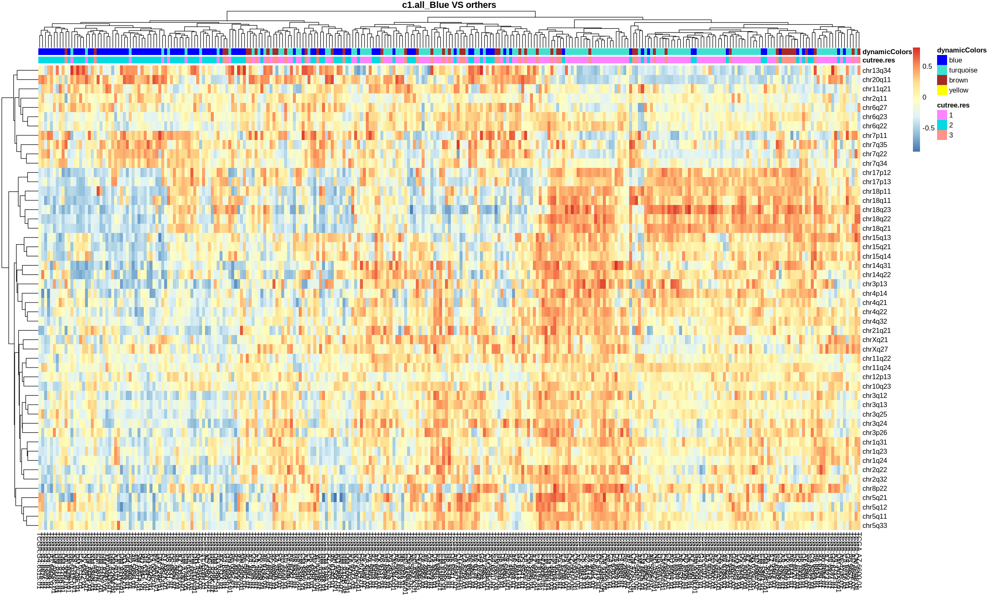

In [15]:
###################### COAD.c1.all.Set #################
## Cut off
library(limma)
fit.c1 <- lmFit(COAD.c1.all.Set, design)
contrast.matrix <- makeContrasts(blue-(brown+turquoise)/2, 
                                 brown-(blue+turquoise)/2,
                                 turquoise-(brown+blue)/2,
                                 levels=design)
fit.c1.2 <- contrasts.fit(fit.c1, contrast.matrix)
fit.c1.2 <- eBayes(fit.c1.2)
plotMD(fit.c1.2)
plotMD(fit.c1.2, column = 2)
plotMD(fit.c1.2, column = 3)
## Find Top significant genesets
## Cut off
adjPvalueCutoff <- 0.01
number = 50
## 
dt <- decideTests(fit.c1.2, p.value = adjPvalueCutoff )
summary(dt)
DEgeneSets.blue.c1 <- topTable(fit.c1.2, coef="blue - (brown + turquoise)/2", number=number,
                               p.value=adjPvalueCutoff,adjust="BH")
DEgeneSets.brown.c1 <- topTable(fit.c1.2, coef="brown - (blue + turquoise)/2", number=number,
                                p.value=adjPvalueCutoff,adjust="BH")
DEgeneSets.turquoise.c1 <- topTable(fit.c1.2, coef="turquoise - (brown + blue)/2", number=number,
                                    p.value=adjPvalueCutoff,adjust="BH")
## Ploting
library(pheatmap)
ann_colors = list(dynamicColors = c(blue = "blue",turquoise = "turquoise", 
                                    brown = "brown", yellow = "yellow"))
#pheatmap::pheatmap(COAD.c1.all.Set,annotation_col = pData(COAD.h.all.Set),
#                   main = "c1.all_all",show_colnames = F)
pheatmap::pheatmap(COAD.c1.all.Set[rownames(DEgeneSets.blue.c1),],annotation_col = pData(COAD.c1.all.Set),
                   main = "c1.all_Blue VS orthers",annotation_colors = ann_colors)
pheatmap::pheatmap(COAD.c1.all.Set[rownames(DEgeneSets.brown.c1),],annotation_col = pData(COAD.c1.all.Set),
                   main = "c1.all_Brown VS orthers",annotation_colors = ann_colors)
pheatmap::pheatmap(COAD.c1.all.Set[rownames(DEgeneSets.turquoise.c1),],annotation_col = pData(COAD.c1.all.Set),
                   main = "c1.all_turquoise VS orthers",annotation_colors = ann_colors)

pheatmap::pheatmap(COAD.c1.all.Set,annotation_col = pData(COAD.c1.all.Set),
                   main = "c1.all_All",annotation_colors = ann_colors)

Coefficients not estimable: yellow 


Warning message:
“Partial NA coefficients for 4655 probe(s)”

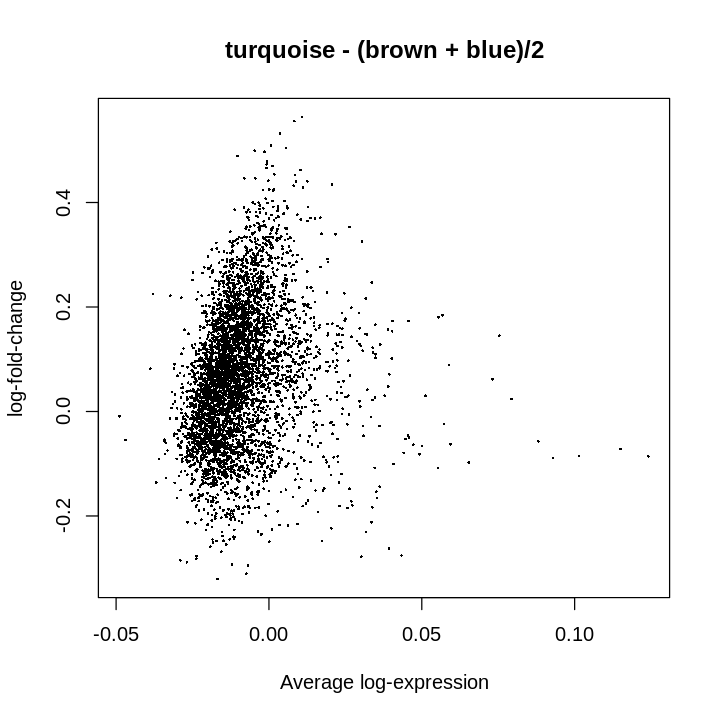

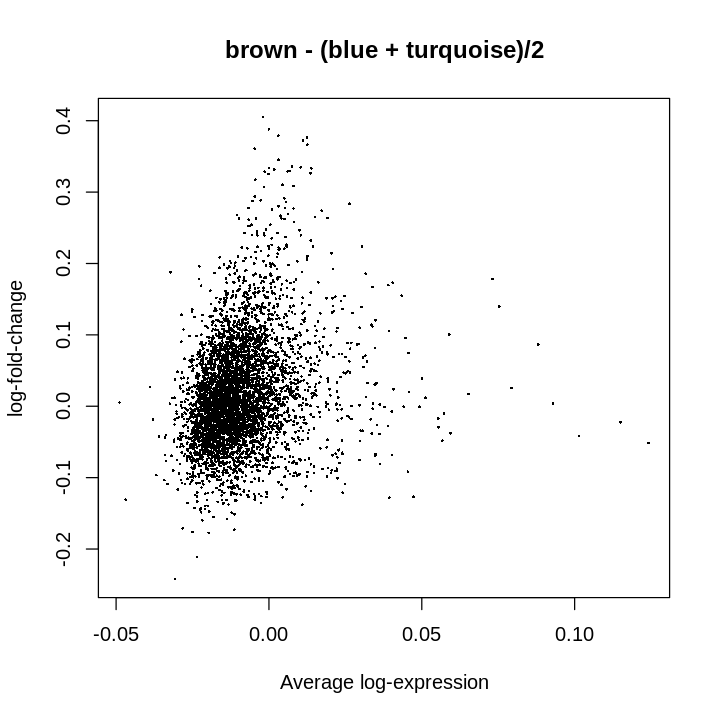

       blue - (brown + turquoise)/2 brown - (blue + turquoise)/2
Down                           2390                           25
NotSig                         1634                         4287
Up                              631                          343
       turquoise - (brown + blue)/2
Down                            494
NotSig                         1898
Up                             2263

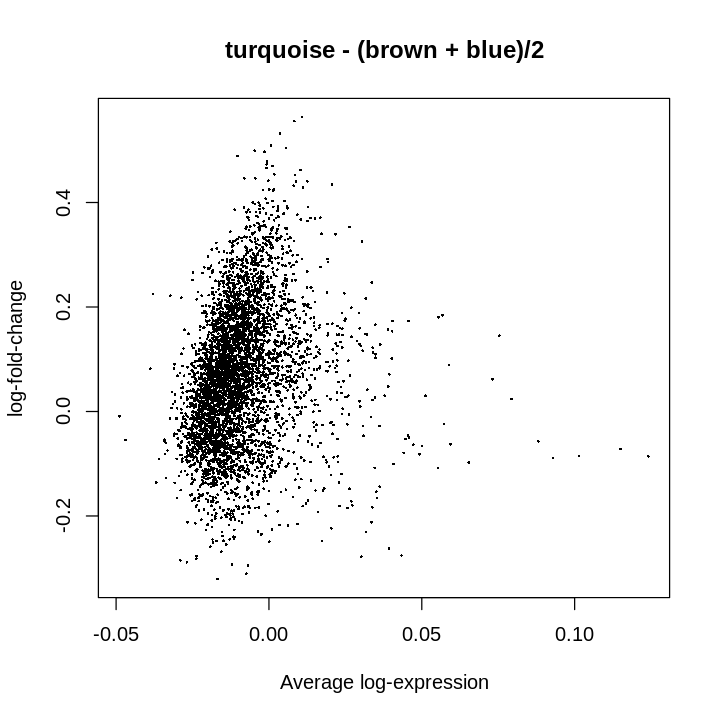

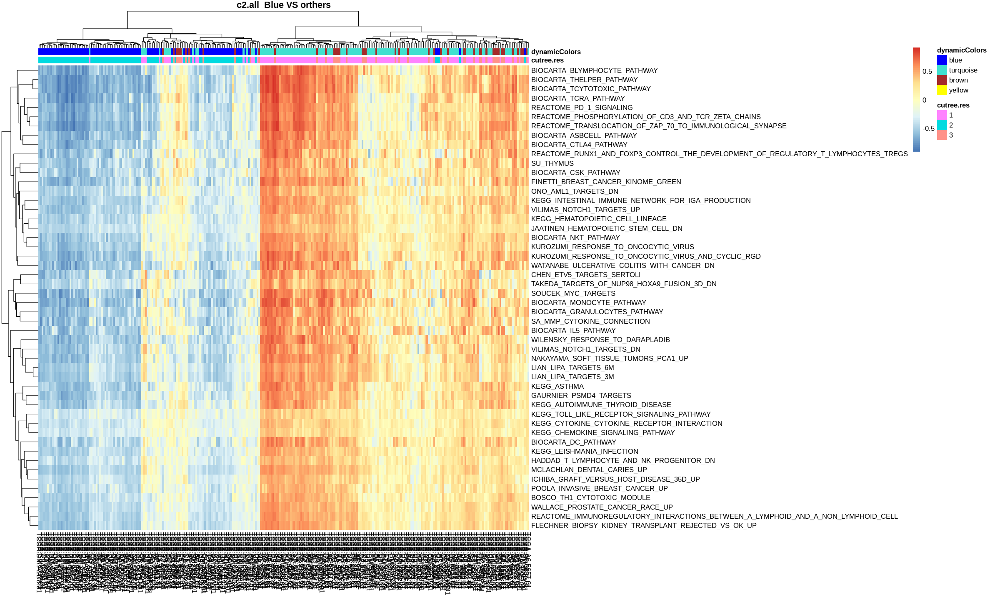

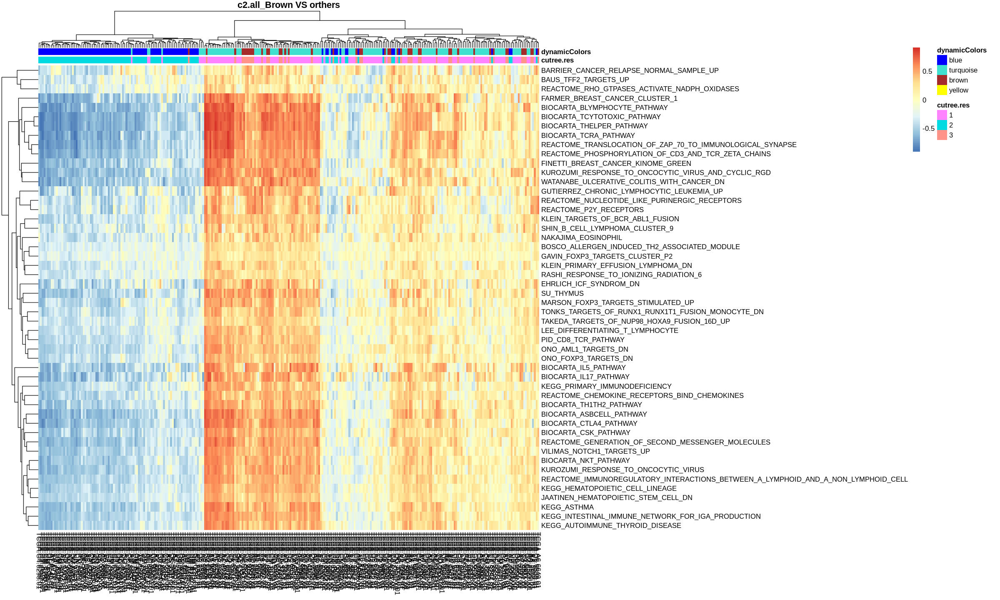

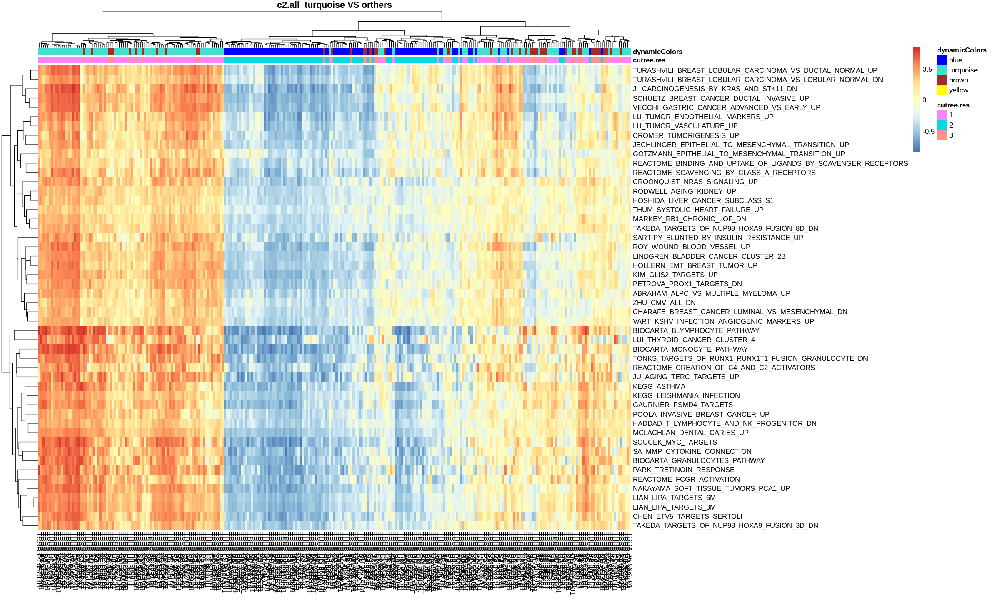

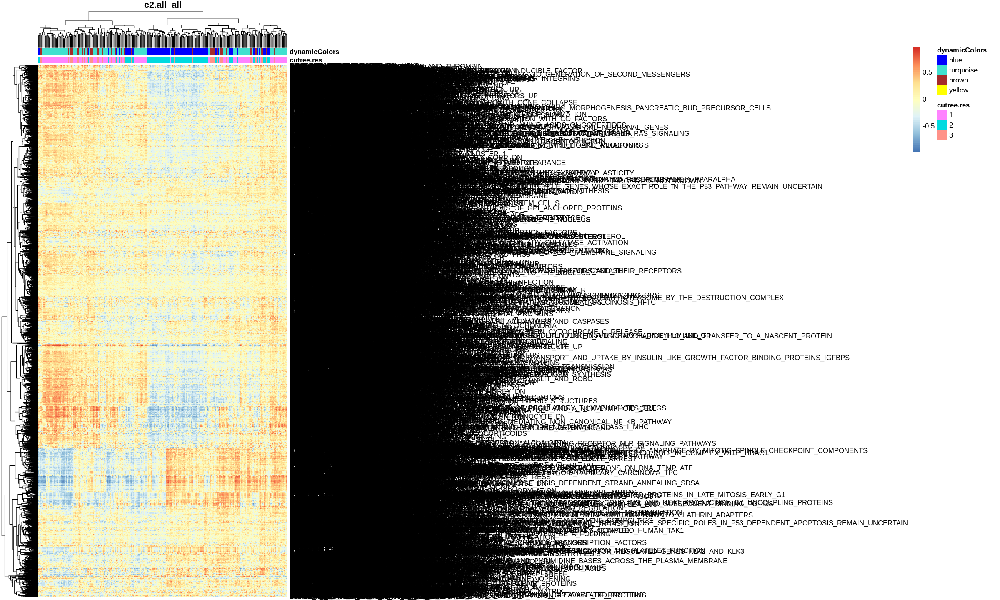

In [10]:
###################### COAD.c2.all.Set #################
## Cut off
library(limma)
fit.c2 <- lmFit(COAD.c2.all.Set, design)
contrast.matrix <- makeContrasts(blue-(brown+turquoise)/2, 
                                 brown-(blue+turquoise)/2,
                                 turquoise-(brown+blue)/2,
                                 levels=design)
fit.c2.2 <- contrasts.fit(fit.c2, contrast.matrix)
fit.c2.2 <- eBayes(fit.c2.2)
options(repr.plot.width=6, repr.plot.height=6)
plotMD(fit.c2.2)
plotMD(fit.c2.2, column = 2)
plotMD(fit.c2.2, column = 3)
## Find Top significant genesets
## Cut off
adjPvalueCutoff <- 0.01
number = 50
## 
dt <- decideTests(fit.c2.2, p.value = adjPvalueCutoff )
summary(dt)
DEgeneSets.blue.c2 <- topTable(fit.c2.2, coef="blue - (brown + turquoise)/2", number=number,
                              p.value=adjPvalueCutoff,adjust="BH")
DEgeneSets.brown.c2 <- topTable(fit.c2.2, coef="brown - (blue + turquoise)/2", number=number,
                               p.value=adjPvalueCutoff,adjust="BH")
DEgeneSets.turquoise.c2 <- topTable(fit.c2.2, coef="turquoise - (brown + blue)/2", number=number,
                                   p.value=adjPvalueCutoff,adjust="BH")
## Ploting
library(pheatmap)
options(repr.plot.width=20, repr.plot.height=12)
ann_colors = list(dynamicColors = c(blue = "blue",turquoise = "turquoise", 
                                    brown = "brown", yellow = "yellow"))

pheatmap::pheatmap(COAD.c2.all.Set[rownames(DEgeneSets.blue.c2),],annotation_col = pData(COAD.c2.all.Set),
                   main = "c2.all_Blue VS orthers",annotation_colors = ann_colors)
pheatmap::pheatmap(COAD.c2.all.Set[rownames(DEgeneSets.brown.c2),],annotation_col = pData(COAD.c2.all.Set),
                   main = "c2.all_Brown VS orthers",annotation_colors = ann_colors)
pheatmap::pheatmap(COAD.c2.all.Set[rownames(DEgeneSets.turquoise.c2),],annotation_col = pData(COAD.c2.all.Set),
                   main = "c2.all_turquoise VS orthers",annotation_colors = ann_colors)
pheatmap::pheatmap(COAD.c2.all.Set,annotation_col = pData(COAD.h.all.Set),
                   main = "c2.all_all",show_colnames = F,annotation_colors = ann_colors)

Coefficients not estimable: yellow 


Warning message:
“Partial NA coefficients for 781 probe(s)”

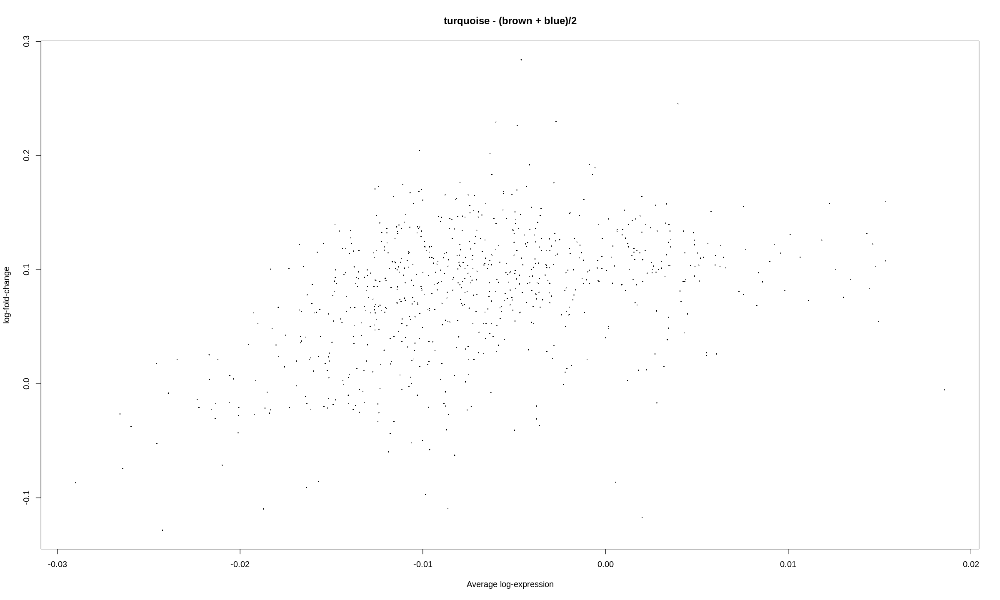

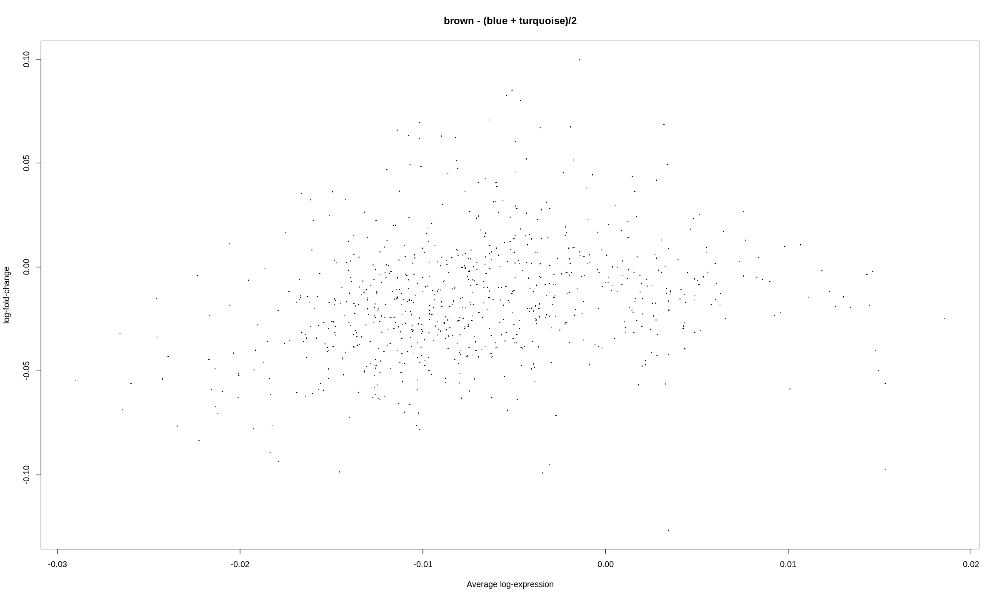

       blue - (brown + turquoise)/2 brown - (blue + turquoise)/2
Down                            505                            2
NotSig                          236                          778
Up                               40                            1
       turquoise - (brown + blue)/2
Down                             19
NotSig                          173
Up                              589

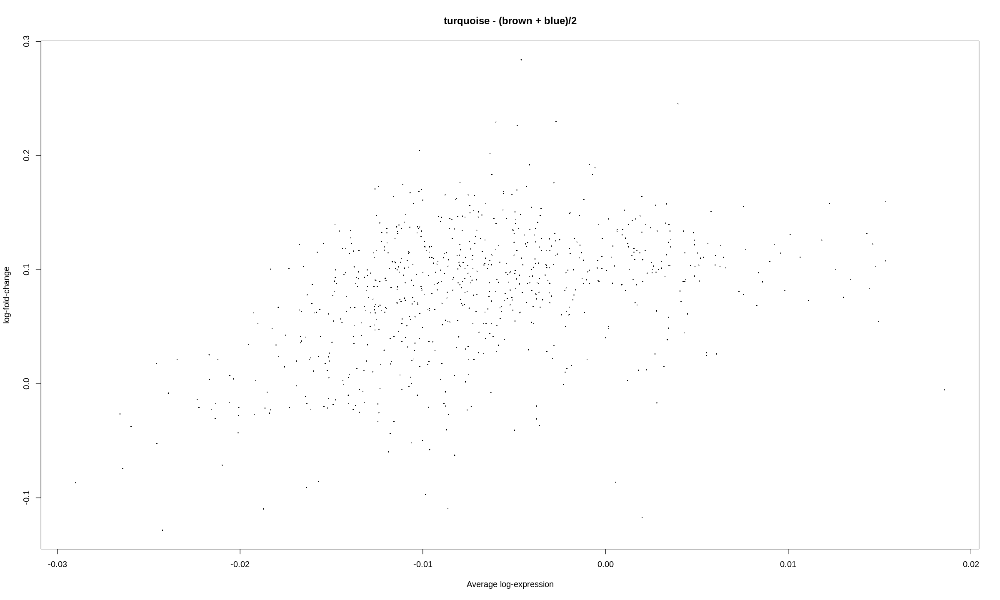

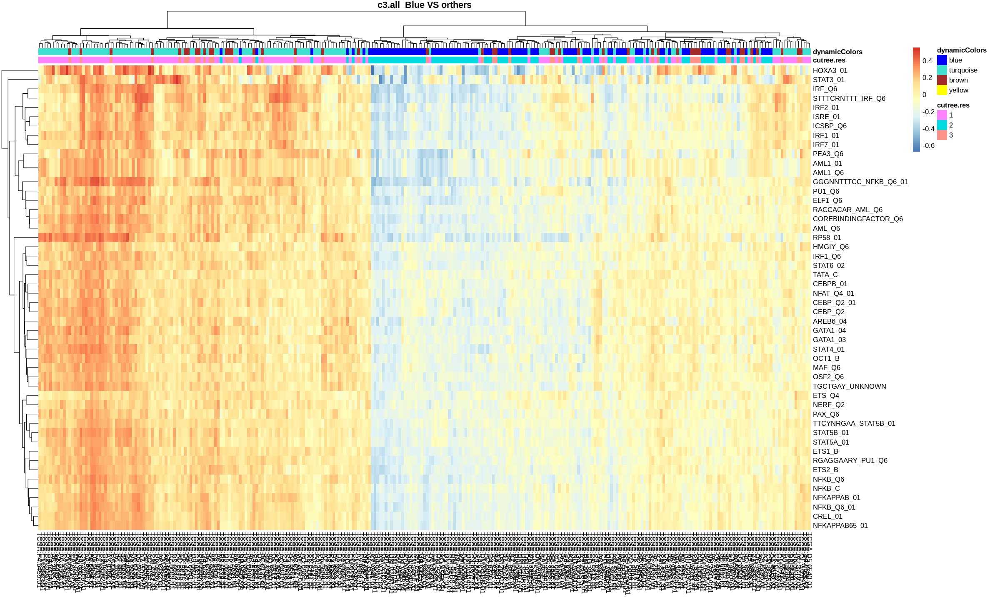

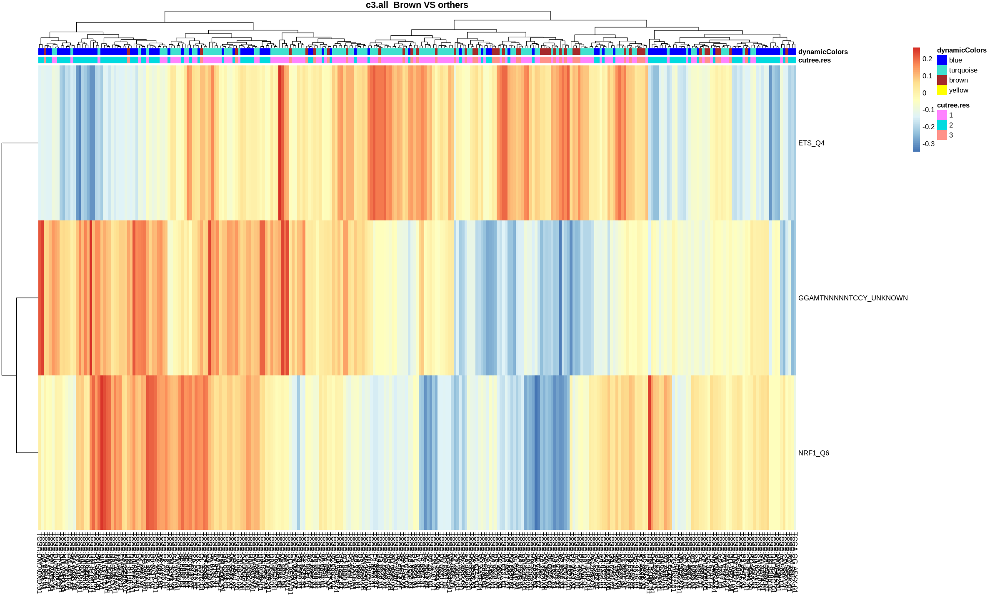

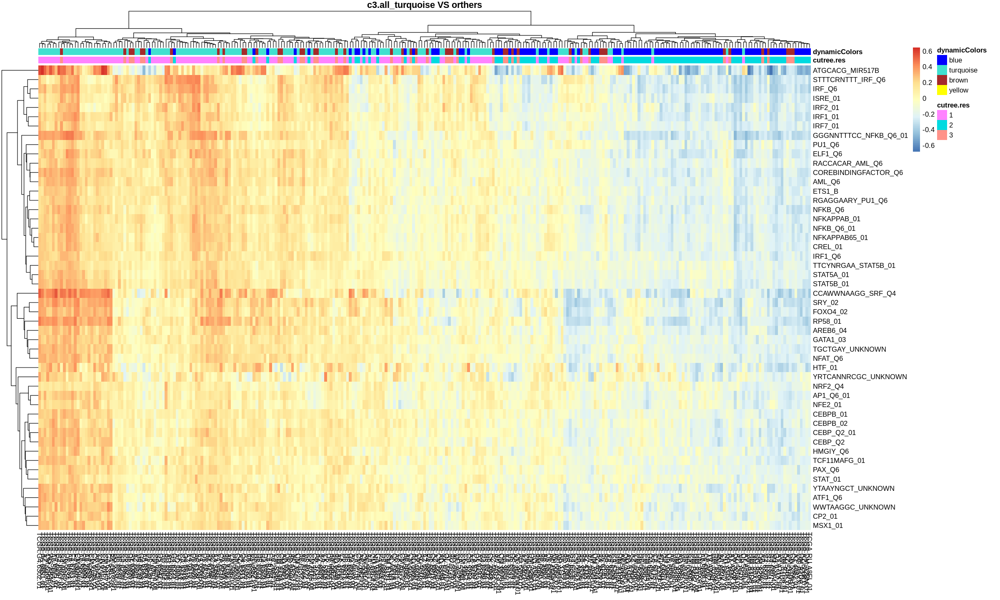

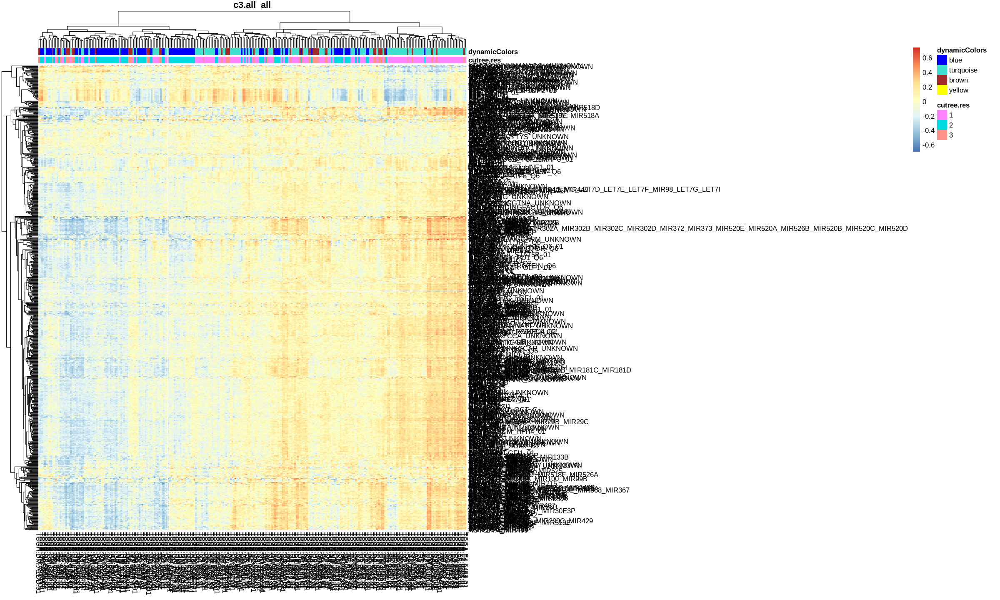

In [12]:
###################### COAD.c3.all.Set #################
## Cut off
library(limma)
fit.c3 <- lmFit(COAD.c3.all.Set, design)
contrast.matrix <- makeContrasts(blue-(brown+turquoise)/2, 
                                 brown-(blue+turquoise)/2,
                                 turquoise-(brown+blue)/2,
                                 levels=design)
fit.c3.2 <- contrasts.fit(fit.c3, contrast.matrix)
fit.c3.2 <- eBayes(fit.c3.2)
plotMD(fit.c3.2)
plotMD(fit.c3.2, column = 2)
plotMD(fit.c3.2, column = 3)
## Find Top significant genesets
## Cut off
adjPvalueCutoff <- 0.01
number = 50
## 
dt <- decideTests(fit.c3.2, p.value = adjPvalueCutoff )
summary(dt)
DEgeneSets.blue.c3 <- topTable(fit.c3.2, coef="blue - (brown + turquoise)/2", number=number,
                               p.value=adjPvalueCutoff,adjust="BH")
DEgeneSets.brown.c3 <- topTable(fit.c3.2, coef="brown - (blue + turquoise)/2", number=number,
                                p.value=adjPvalueCutoff,adjust="BH")
DEgeneSets.turquoise.c3 <- topTable(fit.c3.2, coef="turquoise - (brown + blue)/2", number=number,
                                    p.value=adjPvalueCutoff,adjust="BH")
## Ploting
library(pheatmap)
ann_colors = list(dynamicColors = c(blue = "blue",turquoise = "turquoise", 
                                    brown = "brown", yellow = "yellow"))
#pheatmap::pheatmap(COAD.c3.all.Set,annotation_col = pData(COAD.h.all.Set),
#                   main = "c3.all_all",show_colnames = F)
options(repr.plot.width=20, repr.plot.height=12)
pheatmap::pheatmap(COAD.c3.all.Set[rownames(DEgeneSets.blue.c3),],annotation_col = pData(COAD.c3.all.Set),
                   main = "c3.all_Blue VS orthers",annotation_colors = ann_colors)
pheatmap::pheatmap(COAD.c3.all.Set[rownames(DEgeneSets.brown.c3),],annotation_col = pData(COAD.c3.all.Set),
                   main = "c3.all_Brown VS orthers",annotation_colors = ann_colors)
pheatmap::pheatmap(COAD.c3.all.Set[rownames(DEgeneSets.turquoise.c3),],annotation_col = pData(COAD.c3.all.Set),
                   main = "c3.all_turquoise VS orthers",annotation_colors = ann_colors)

pheatmap::pheatmap(COAD.c3.all.Set,annotation_col = pData(COAD.c3.all.Set),
                   main = "c3.all_all",annotation_colors = ann_colors)


Coefficients not estimable: yellow 


Warning message:
“Partial NA coefficients for 840 probe(s)”

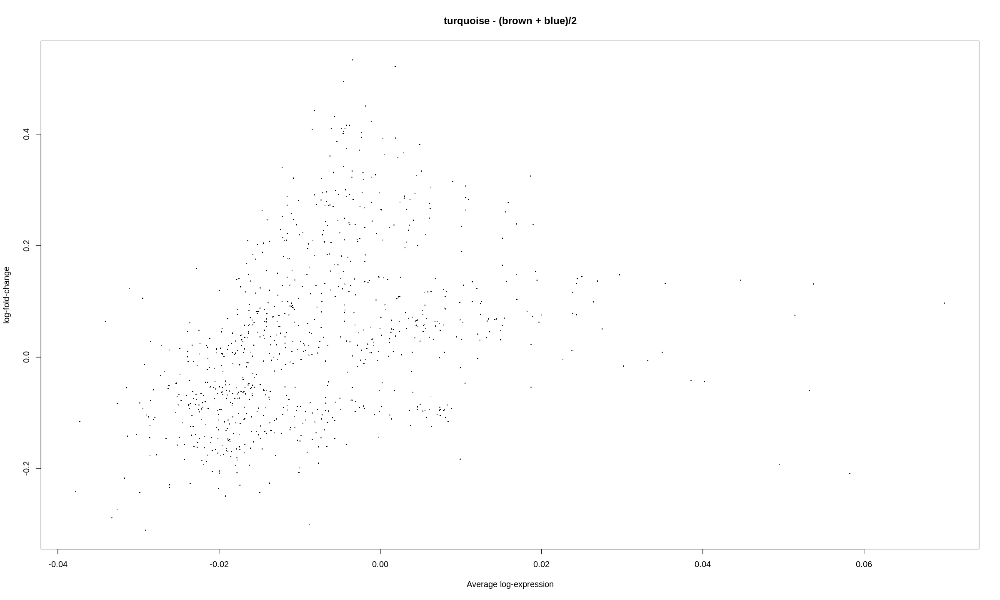

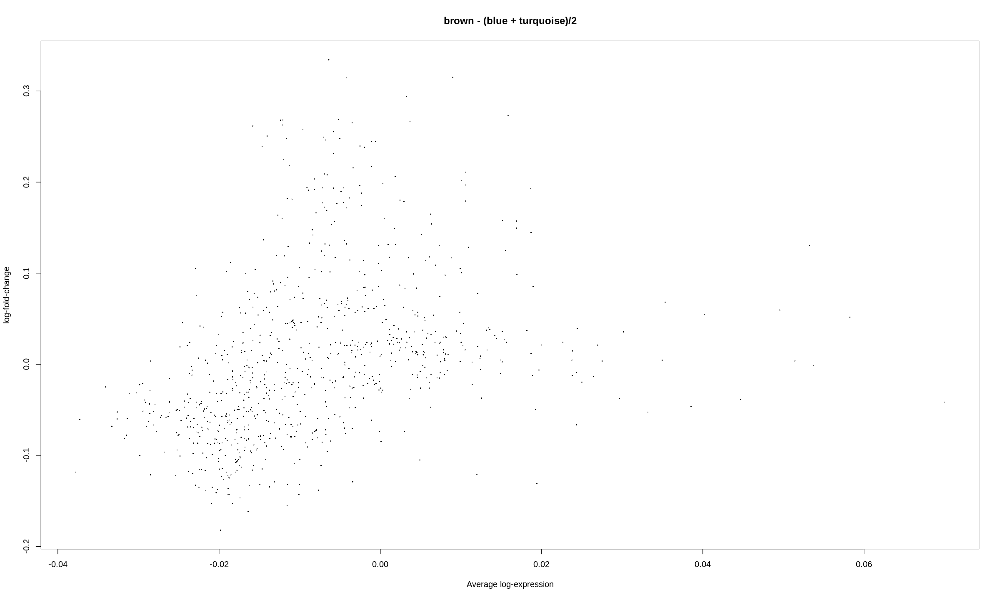

       blue - (brown + turquoise)/2 brown - (blue + turquoise)/2
Down                            359                            7
NotSig                          246                          732
Up                              235                          101
       turquoise - (brown + blue)/2
Down                            156
NotSig                          342
Up                              342

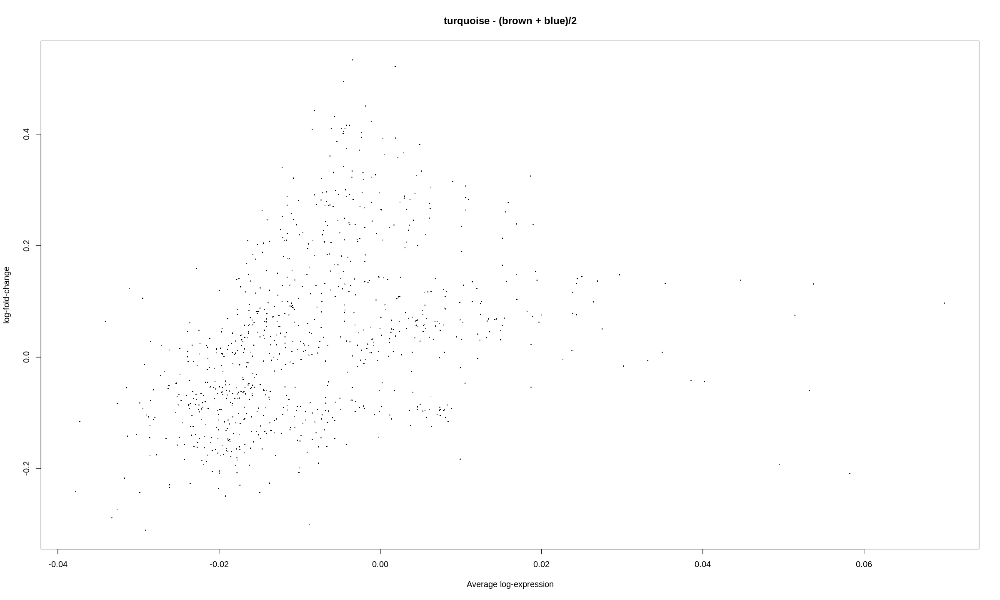

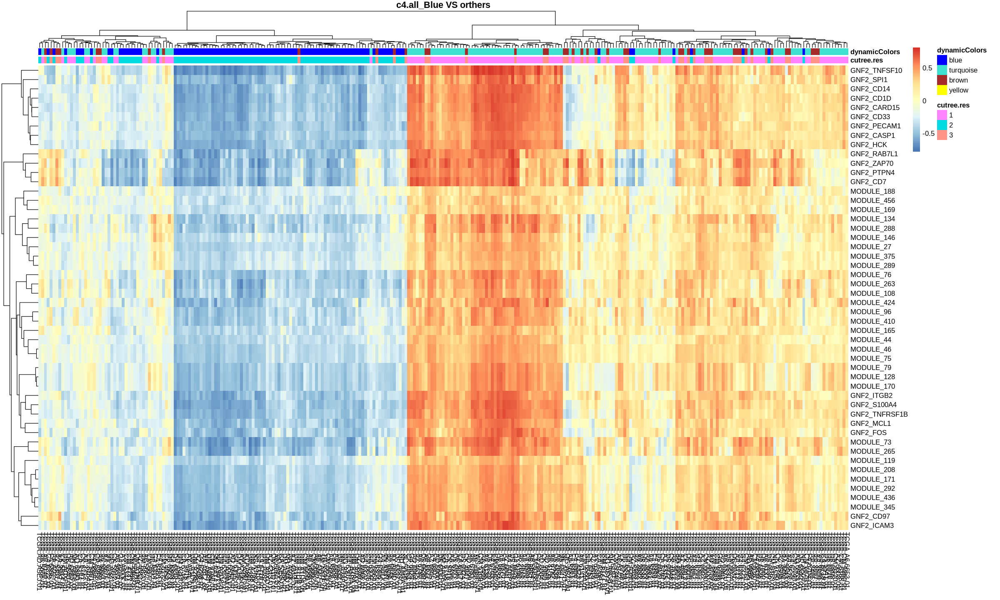

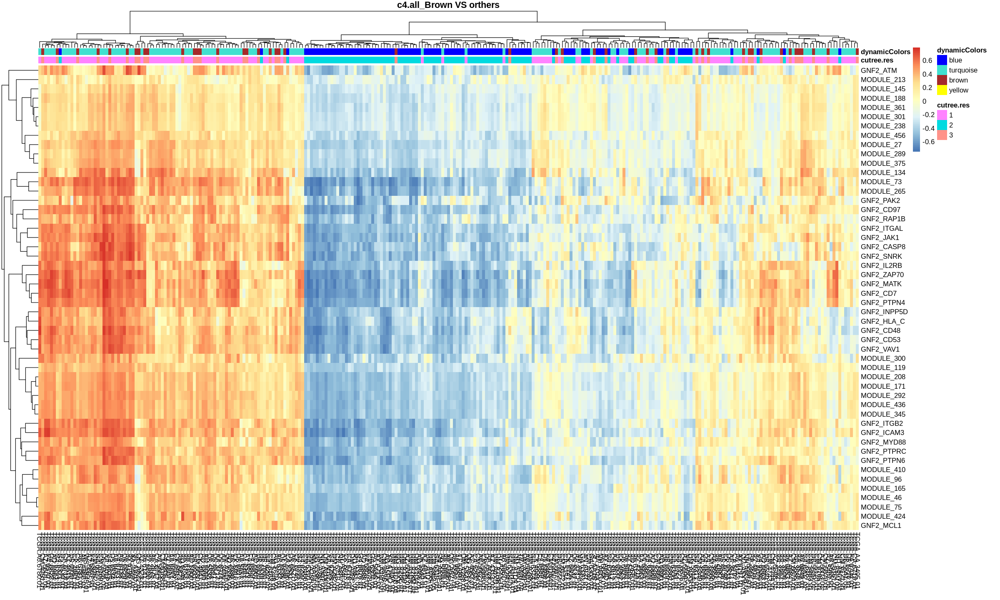

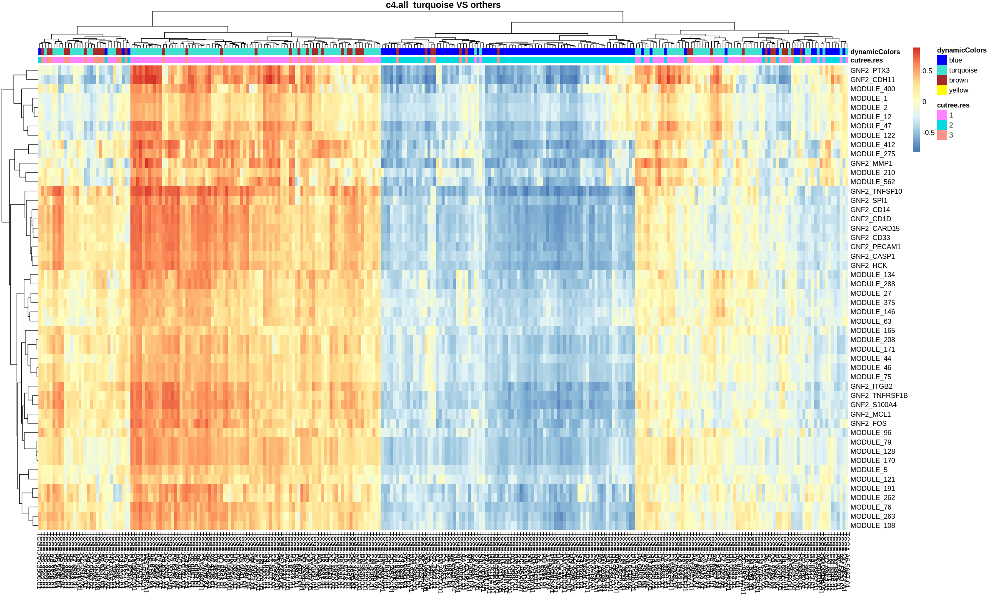

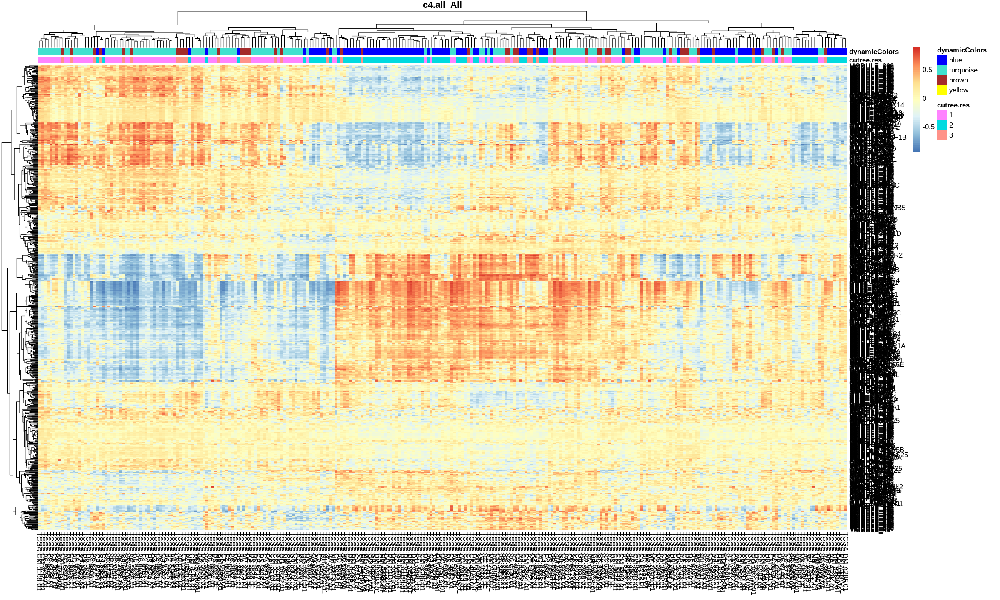

In [13]:
###################### COAD.c4.all.Set #################
## Cut off
library(limma)
fit.c4 <- lmFit(COAD.c4.all.Set, design)
contrast.matrix <- makeContrasts(blue-(brown+turquoise)/2, 
                                 brown-(blue+turquoise)/2,
                                 turquoise-(brown+blue)/2,
                                 levels=design)
fit.c4.2 <- contrasts.fit(fit.c4, contrast.matrix)
fit.c4.2 <- eBayes(fit.c4.2)
plotMD(fit.c4.2)
plotMD(fit.c4.2, column = 2)
plotMD(fit.c4.2, column = 3)
## Find Top significant genesets
## Cut off
adjPvalueCutoff <- 0.01
number = 50
## 
dt <- decideTests(fit.c4.2, p.value = adjPvalueCutoff )
summary(dt)
DEgeneSets.blue.c4 <- topTable(fit.c4.2, coef="blue - (brown + turquoise)/2", number=number,
                               p.value=adjPvalueCutoff,adjust="BH")
DEgeneSets.brown.c4 <- topTable(fit.c4.2, coef="brown - (blue + turquoise)/2", number=number,
                                p.value=adjPvalueCutoff,adjust="BH")
DEgeneSets.turquoise.c4 <- topTable(fit.c4.2, coef="turquoise - (brown + blue)/2", number=number,
                                    p.value=adjPvalueCutoff,adjust="BH")
## Ploting
library(pheatmap)
ann_colors = list(dynamicColors = c(blue = "blue",turquoise = "turquoise", 
                                    brown = "brown", yellow = "yellow"))
#pheatmap::pheatmap(COAD.c4.all.Set,annotation_col = pData(COAD.h.all.Set),
#                   main = "c4.all_all",show_colnames = F)
options(repr.plot.width=20, repr.plot.height=12)
pheatmap::pheatmap(COAD.c4.all.Set[rownames(DEgeneSets.blue.c4),],annotation_col = pData(COAD.c4.all.Set),
                   main = "c4.all_Blue VS orthers",annotation_colors = ann_colors)
pheatmap::pheatmap(COAD.c4.all.Set[rownames(DEgeneSets.brown.c4),],annotation_col = pData(COAD.c4.all.Set),
                   main = "c4.all_Brown VS orthers",annotation_colors = ann_colors)
pheatmap::pheatmap(COAD.c4.all.Set[rownames(DEgeneSets.turquoise.c4),],annotation_col = pData(COAD.c4.all.Set),
                   main = "c4.all_turquoise VS orthers",annotation_colors = ann_colors)

pheatmap::pheatmap(COAD.c4.all.Set,annotation_col = pData(COAD.c4.all.Set),
                   main = "c4.all_All",annotation_colors = ann_colors)


Coefficients not estimable: yellow 


Warning message:
“Partial NA coefficients for 6516 probe(s)”

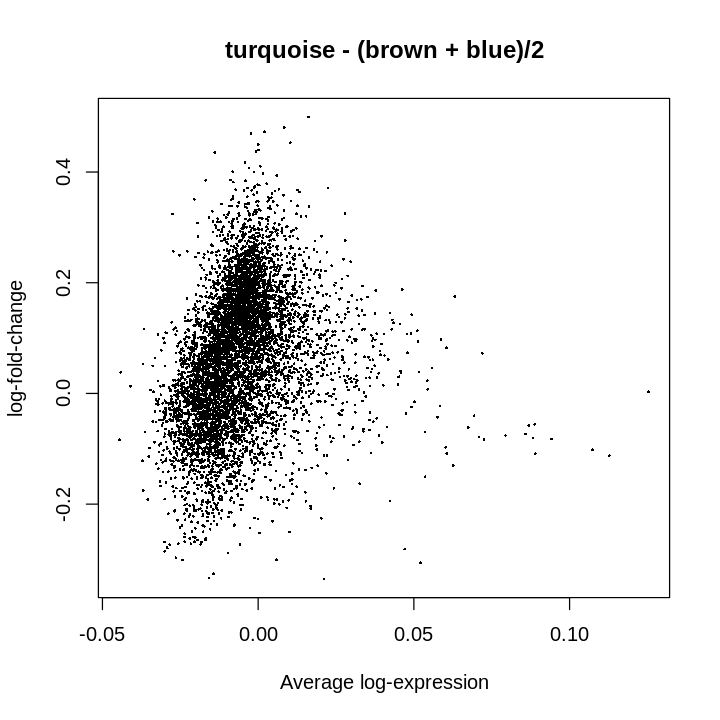

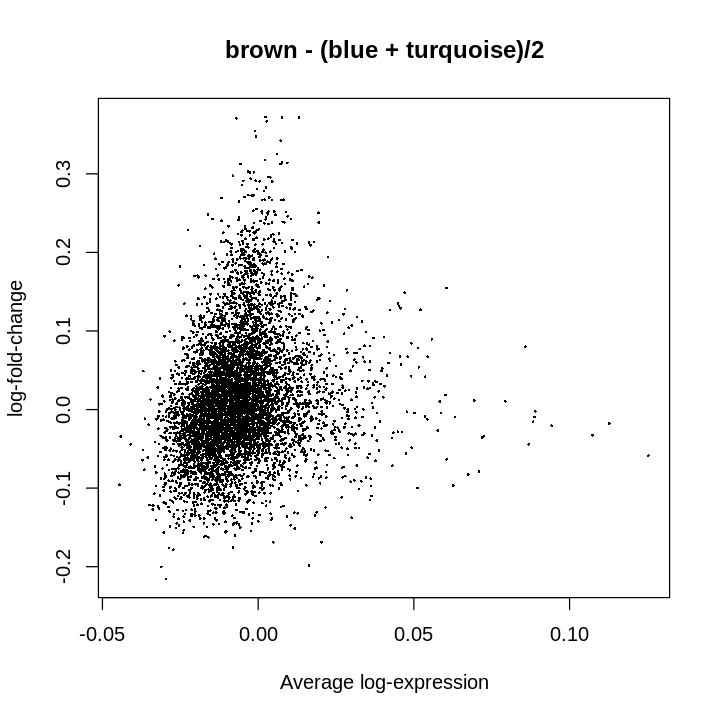

       blue - (brown + turquoise)/2 brown - (blue + turquoise)/2
Down                           3387                           61
NotSig                         2137                         5807
Up                              992                          648
       turquoise - (brown + blue)/2
Down                            751
NotSig                         2432
Up                             3333

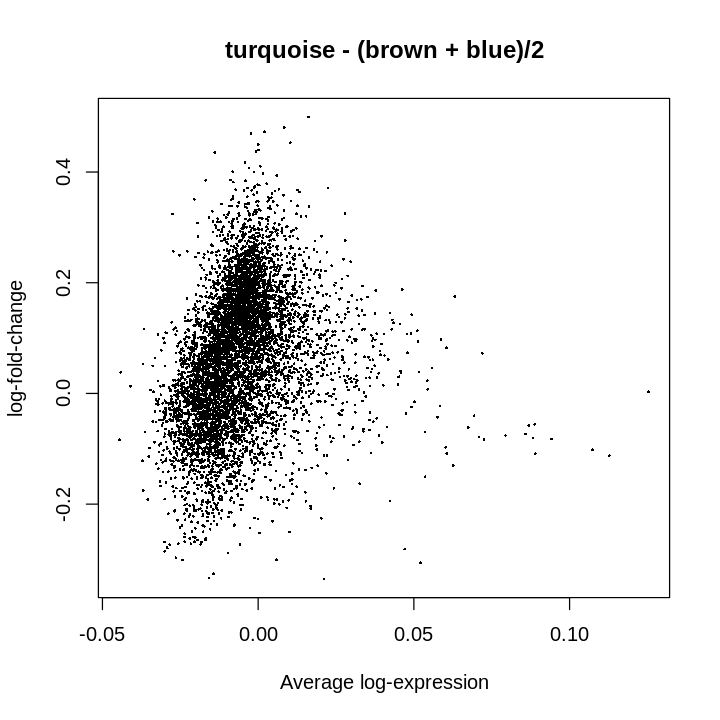

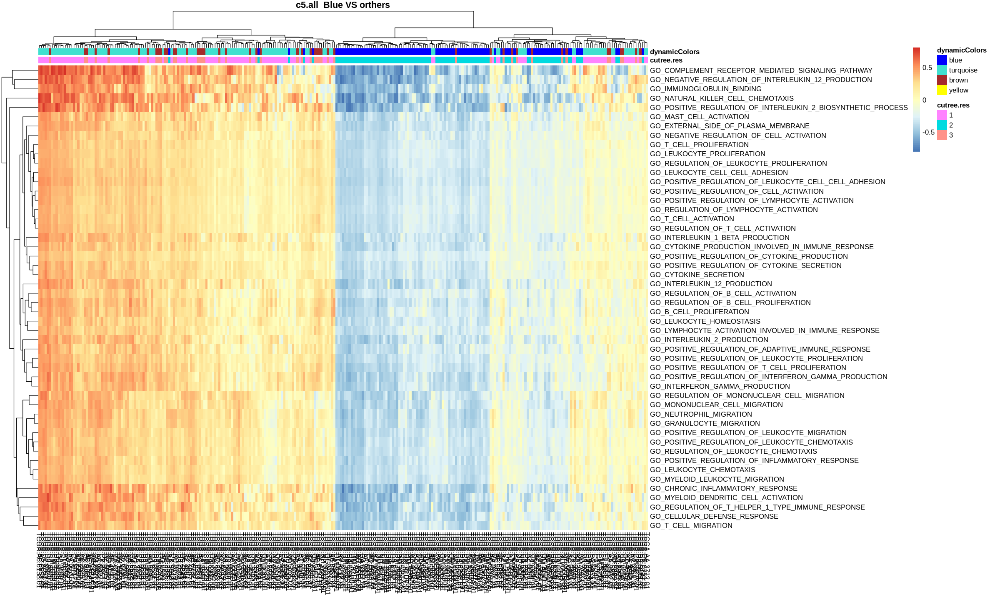

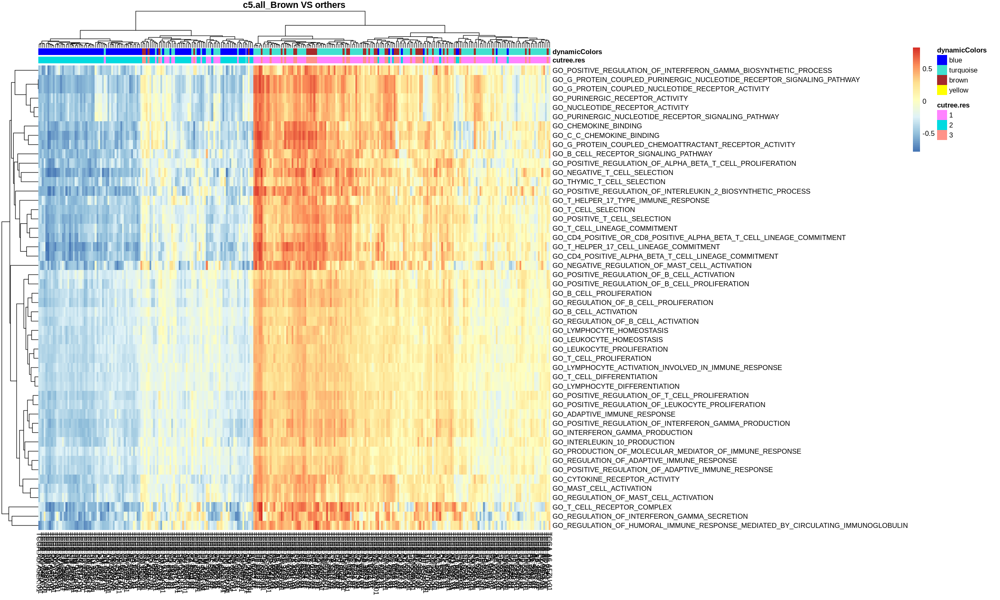

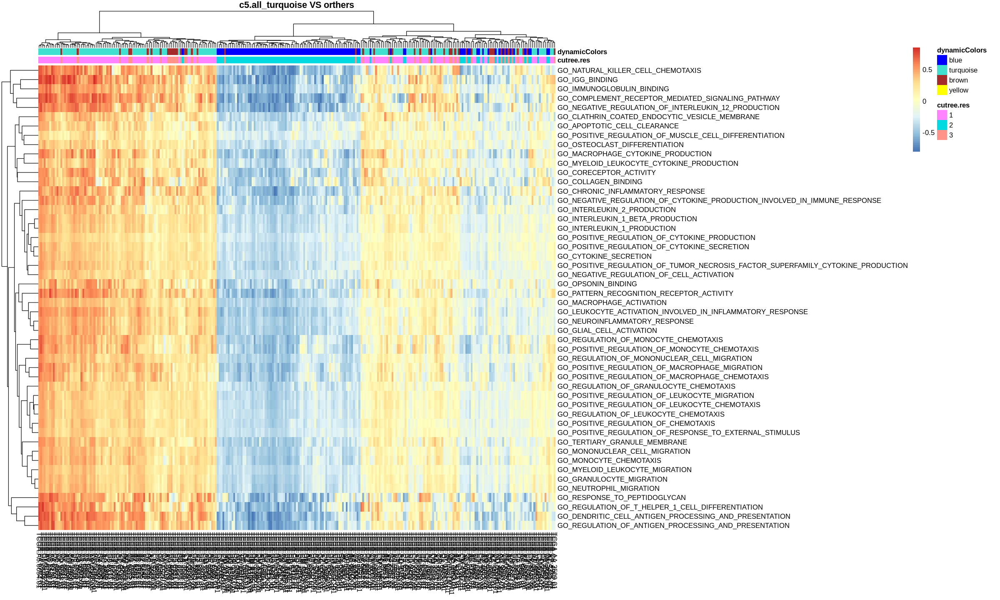

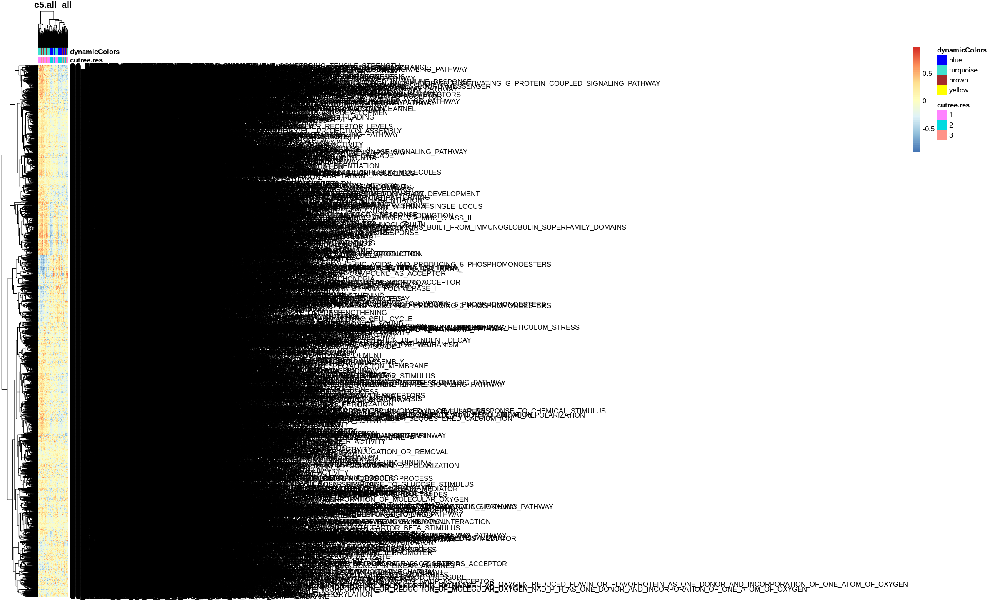

In [16]:
###################### COAD.c5.all.Set #################
## Cut off
library(limma)
fit.c5 <- lmFit(COAD.c5.all.Set, design)
contrast.matrix <- makeContrasts(blue-(brown+turquoise)/2, 
                                 brown-(blue+turquoise)/2,
                                 turquoise-(brown+blue)/2,
                                 levels=design)
fit.c5.2 <- contrasts.fit(fit.c5, contrast.matrix)
fit.c5.2 <- eBayes(fit.c5.2)
options(repr.plot.width=6, repr.plot.height=6)
plotMD(fit.c5.2)
plotMD(fit.c5.2, column = 2)
plotMD(fit.c5.2, column = 3)
## Find Top significant genesets
## Cut off
adjPvalueCutoff <- 0.01
number = 50
## 
dt <- decideTests(fit.c5.2, p.value = adjPvalueCutoff )
summary(dt)
DEgeneSets.blue.c5 <- topTable(fit.c5.2, coef="blue - (brown + turquoise)/2", number=number,
                               p.value=adjPvalueCutoff,adjust="BH")
DEgeneSets.brown.c5 <- topTable(fit.c5.2, coef="brown - (blue + turquoise)/2", number=number,
                                p.value=adjPvalueCutoff,adjust="BH")
DEgeneSets.turquoise.c5 <- topTable(fit.c5.2, coef="turquoise - (brown + blue)/2", number=number,
                                    p.value=adjPvalueCutoff,adjust="BH")
## Ploting
library(pheatmap)
options(repr.plot.width=20, repr.plot.height=12)
ann_colors = list(dynamicColors = c(blue = "blue",turquoise = "turquoise", 
                                    brown = "brown", yellow = "yellow"))

pheatmap::pheatmap(COAD.c5.all.Set[rownames(DEgeneSets.blue.c5),],annotation_col = pData(COAD.c5.all.Set),
                   main = "c5.all_Blue VS orthers",annotation_colors = ann_colors)
pheatmap::pheatmap(COAD.c5.all.Set[rownames(DEgeneSets.brown.c5),],annotation_col = pData(COAD.c5.all.Set),
                   main = "c5.all_Brown VS orthers",annotation_colors = ann_colors)
pheatmap::pheatmap(COAD.c5.all.Set[rownames(DEgeneSets.turquoise.c5),],annotation_col = pData(COAD.c5.all.Set),
                   main = "c5.all_turquoise VS orthers",annotation_colors = ann_colors)
pheatmap::pheatmap(COAD.c5.all.Set,annotation_col = pData(COAD.h.all.Set),show_rowames = F,
                   main = "c5.all_all",show_colnames = F,annotation_colors = ann_colors)

Coefficients not estimable: yellow 


Warning message:
“Partial NA coefficients for 189 probe(s)”

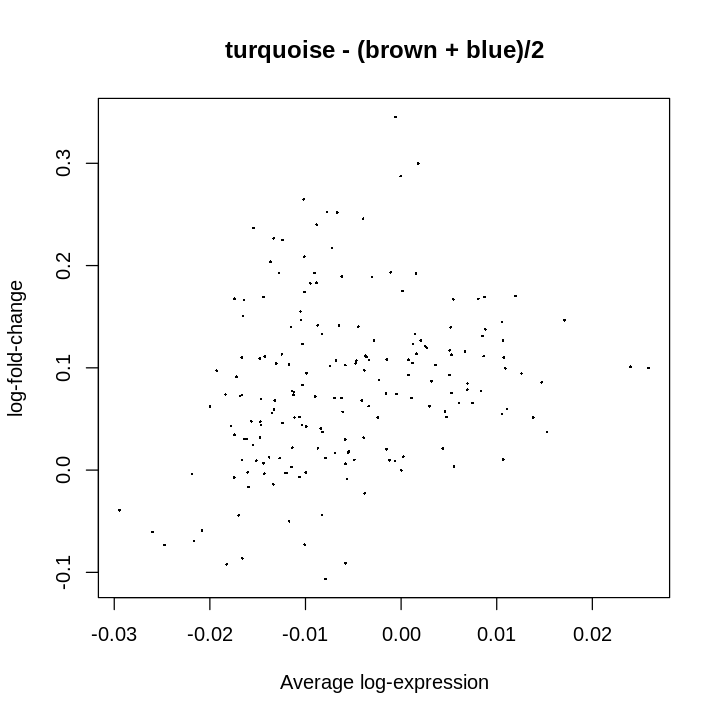

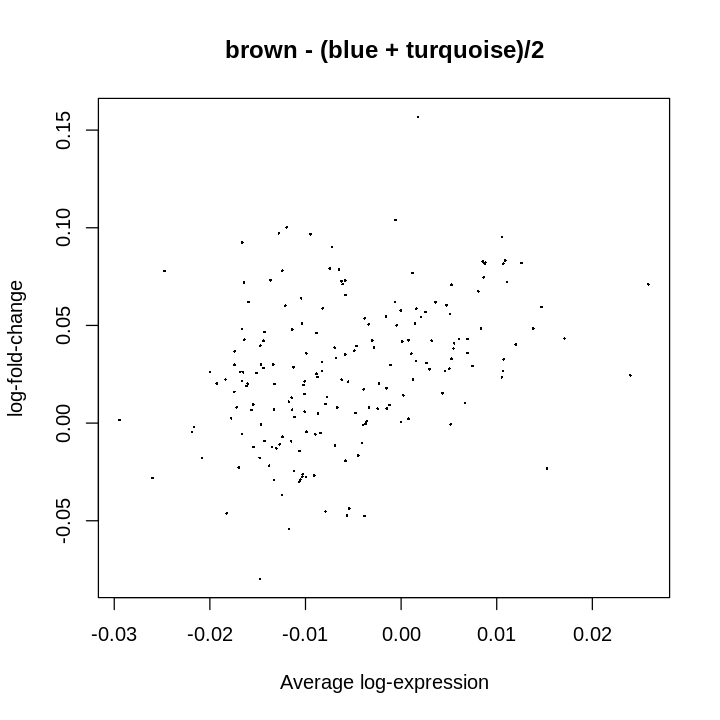

       blue - (brown + turquoise)/2 brown - (blue + turquoise)/2
Down                            140                            0
NotSig                           39                          179
Up                               10                           10
       turquoise - (brown + blue)/2
Down                              6
NotSig                           58
Up                              125

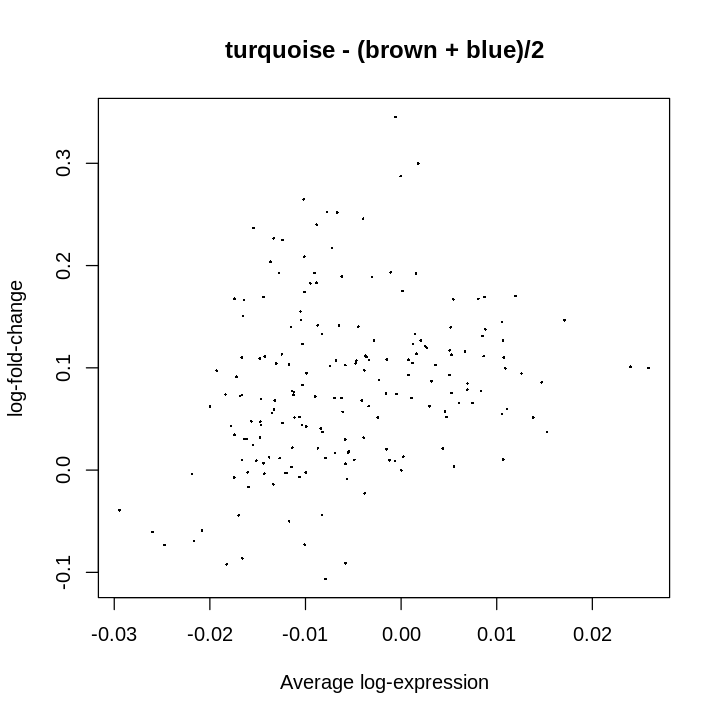

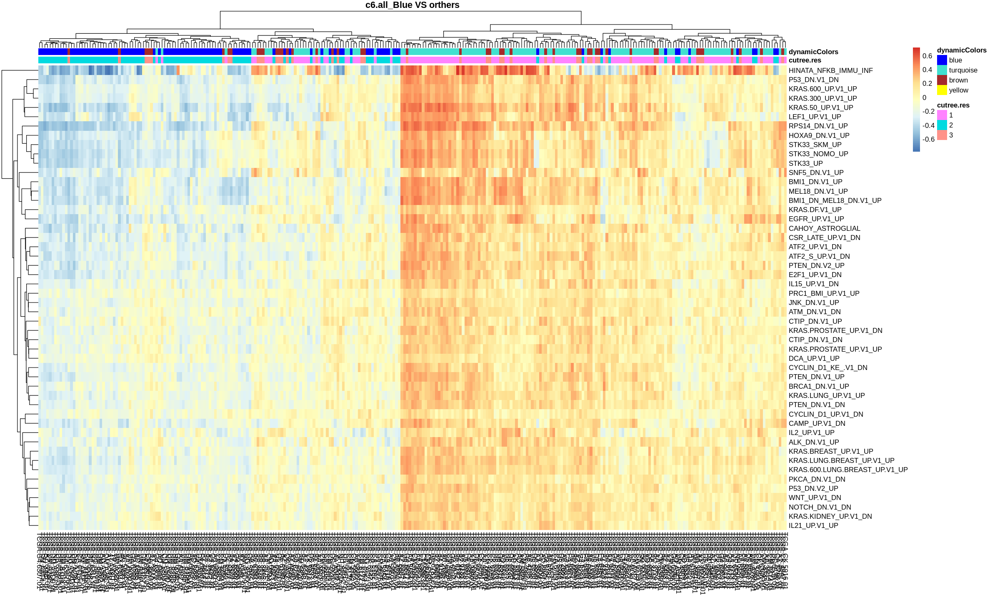

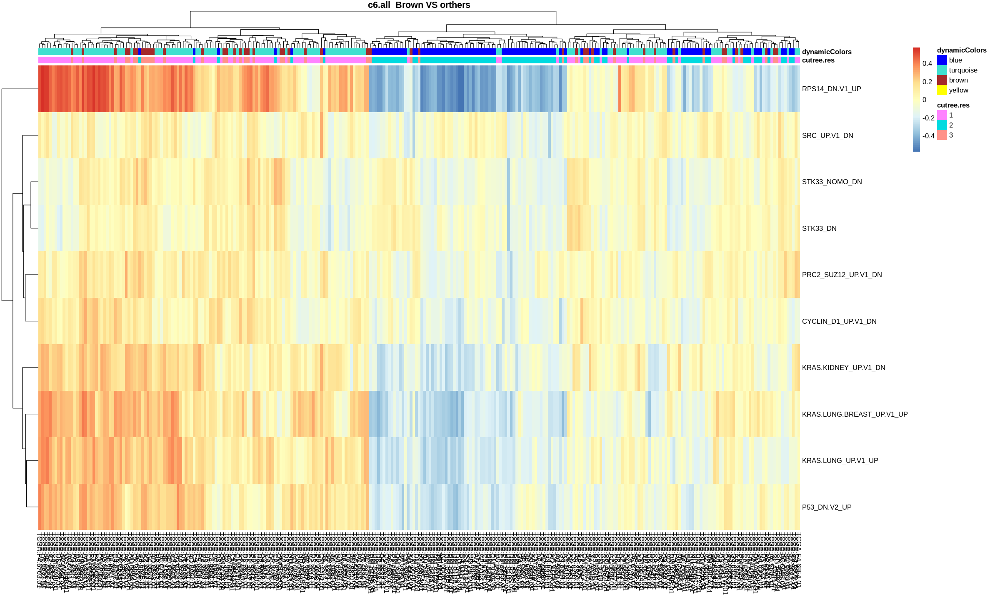

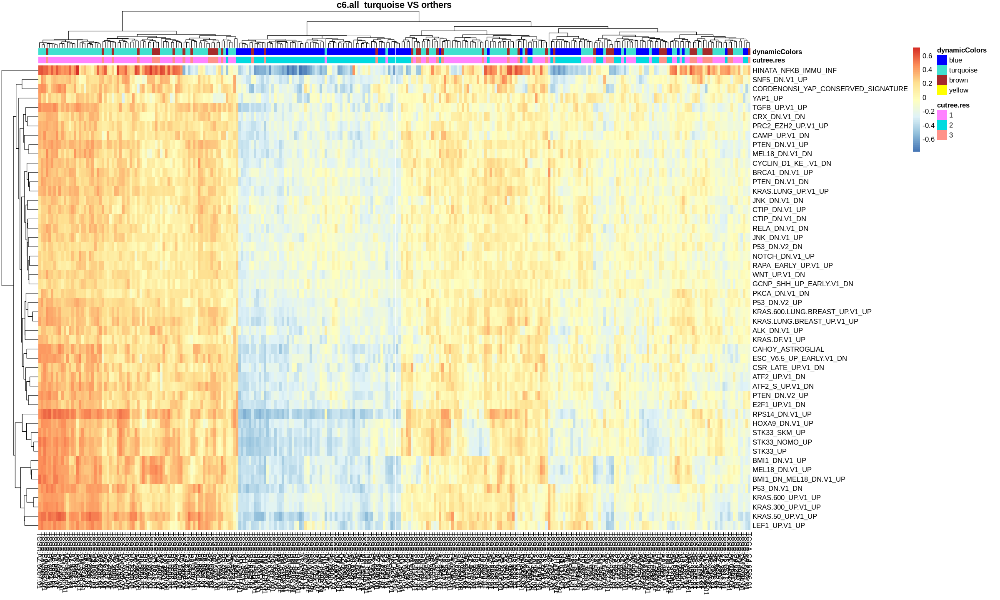

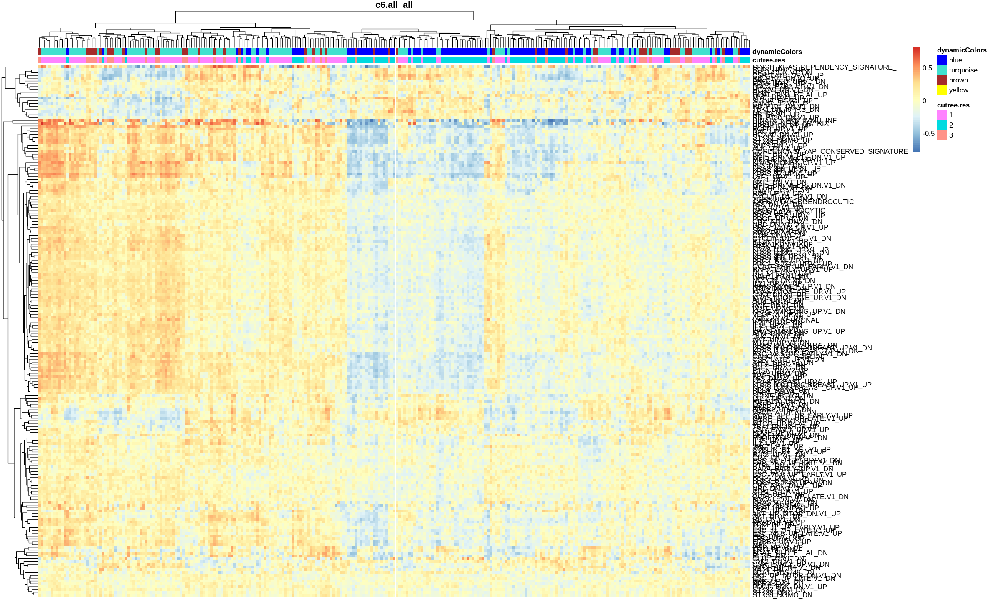

In [13]:
###################### COAD.c6.all.Set #################
## Cut off
library(limma)
fit.c6 <- lmFit(COAD.c6.all.Set, design)
contrast.matrix <- makeContrasts(blue-(brown+turquoise)/2, 
                                 brown-(blue+turquoise)/2,
                                 turquoise-(brown+blue)/2,
                                 levels=design)
fit.c6.2 <- contrasts.fit(fit.c6, contrast.matrix)
fit.c6.2 <- eBayes(fit.c6.2)
options(repr.plot.width=6, repr.plot.height=6)
plotMD(fit.c6.2)
plotMD(fit.c6.2, column = 2)
plotMD(fit.c6.2, column = 3)
## Find Top significant genesets
## Cut off
adjPvalueCutoff <- 0.01
number = 50
## 
dt <- decideTests(fit.c6.2, p.value = adjPvalueCutoff )
summary(dt)
DEgeneSets.blue.c6 <- topTable(fit.c6.2, coef="blue - (brown + turquoise)/2", number=number,
                               p.value=adjPvalueCutoff,adjust="BH")
DEgeneSets.brown.c6 <- topTable(fit.c6.2, coef="brown - (blue + turquoise)/2", number=number,
                                p.value=adjPvalueCutoff,adjust="BH")
DEgeneSets.turquoise.c6 <- topTable(fit.c6.2, coef="turquoise - (brown + blue)/2", number=number,
                                    p.value=adjPvalueCutoff,adjust="BH")
## Ploting
library(pheatmap)
options(repr.plot.width=20, repr.plot.height=12)
ann_colors = list(dynamicColors = c(blue = "blue",turquoise = "turquoise", 
                                    brown = "brown", yellow = "yellow"))

pheatmap::pheatmap(COAD.c6.all.Set[rownames(DEgeneSets.blue.c6),],annotation_col = pData(COAD.c6.all.Set),
                   main = "c6.all_Blue VS orthers",annotation_colors = ann_colors)
pheatmap::pheatmap(COAD.c6.all.Set[rownames(DEgeneSets.brown.c6),],annotation_col = pData(COAD.c6.all.Set),
                   main = "c6.all_Brown VS orthers",annotation_colors = ann_colors)
pheatmap::pheatmap(COAD.c6.all.Set[rownames(DEgeneSets.turquoise.c6),],annotation_col = pData(COAD.c6.all.Set),
                   main = "c6.all_turquoise VS orthers",annotation_colors = ann_colors)
pheatmap::pheatmap(COAD.c6.all.Set,annotation_col = pData(COAD.h.all.Set),
                   main = "c6.all_all",show_colnames = F,annotation_colors = ann_colors)

Coefficients not estimable: yellow 


Warning message:
“Partial NA coefficients for 4872 probe(s)”

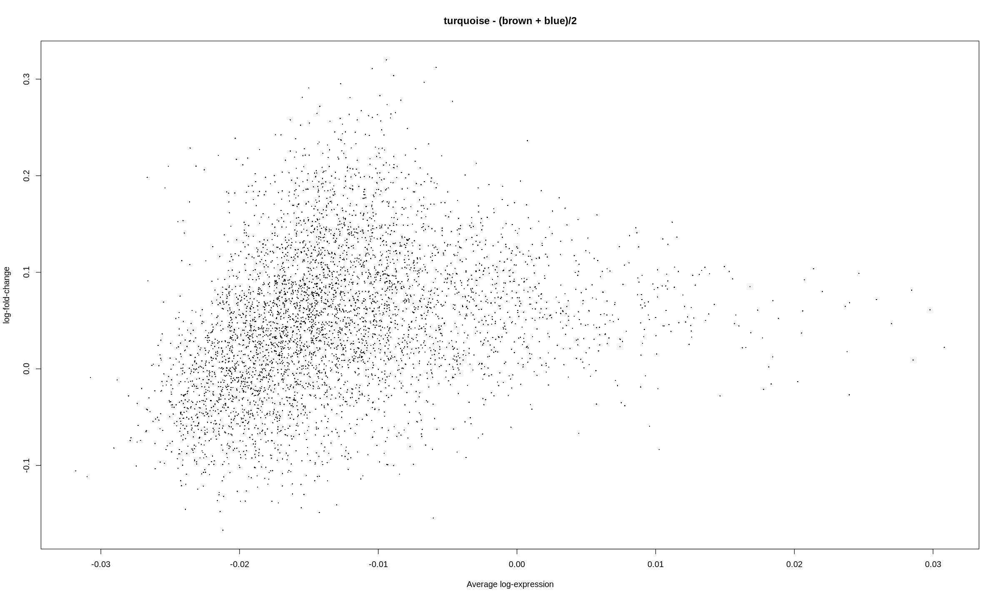

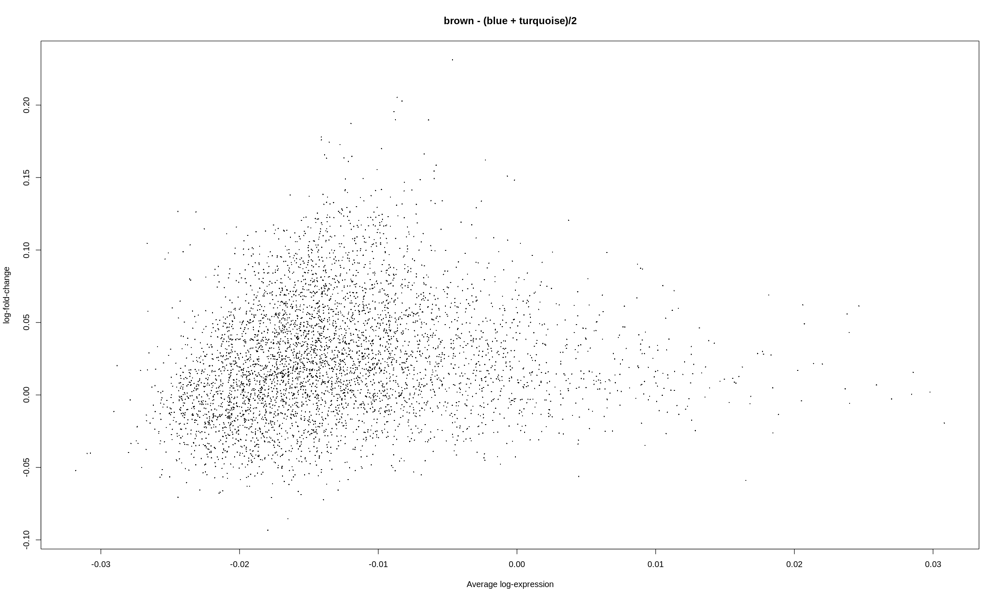

       blue - (brown + turquoise)/2 brown - (blue + turquoise)/2
Down                           2989                            9
NotSig                         1387                         4310
Up                              496                          553
       turquoise - (brown + blue)/2
Down                            347
NotSig                         1886
Up                             2639

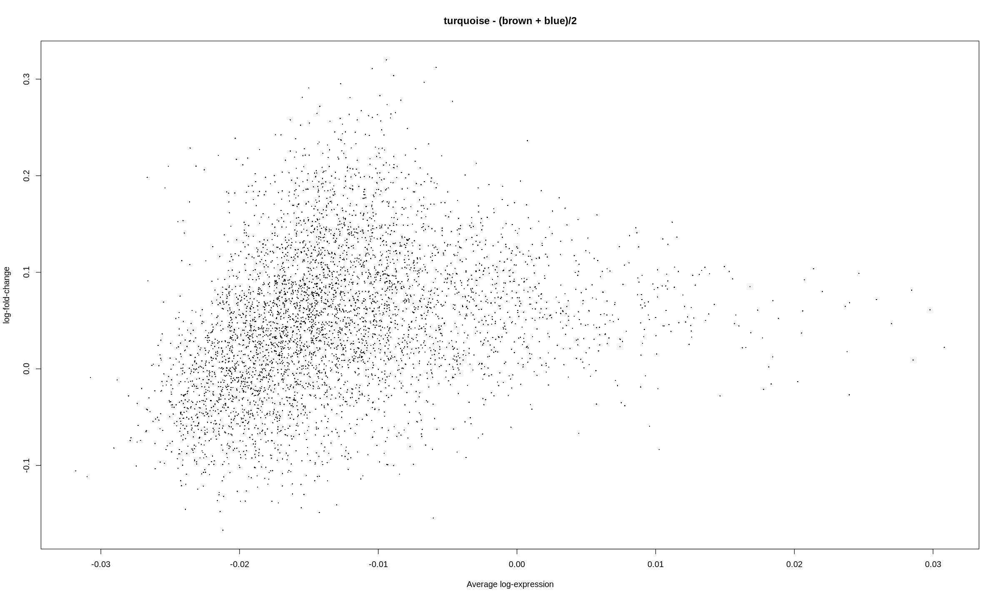

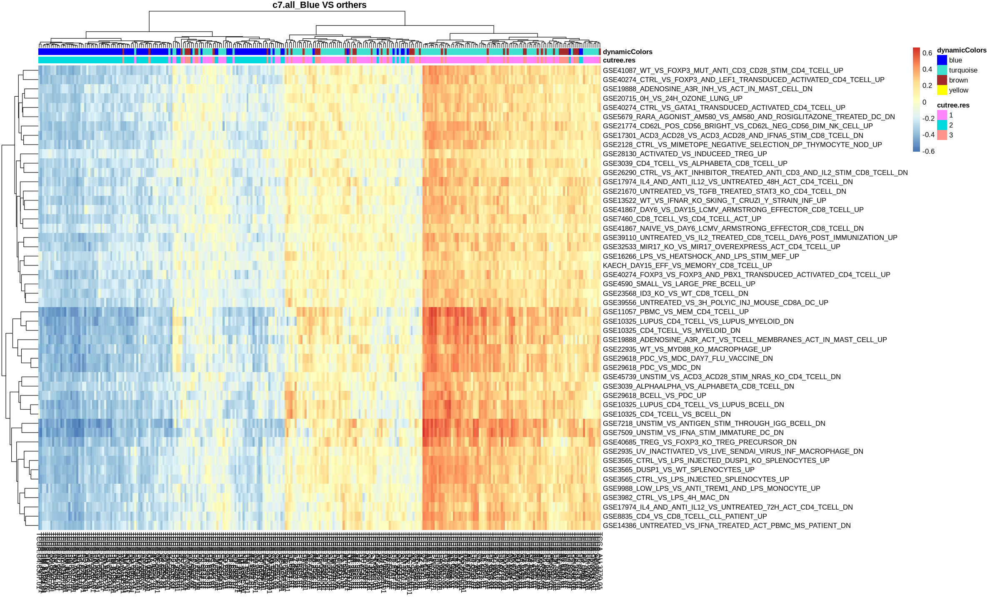

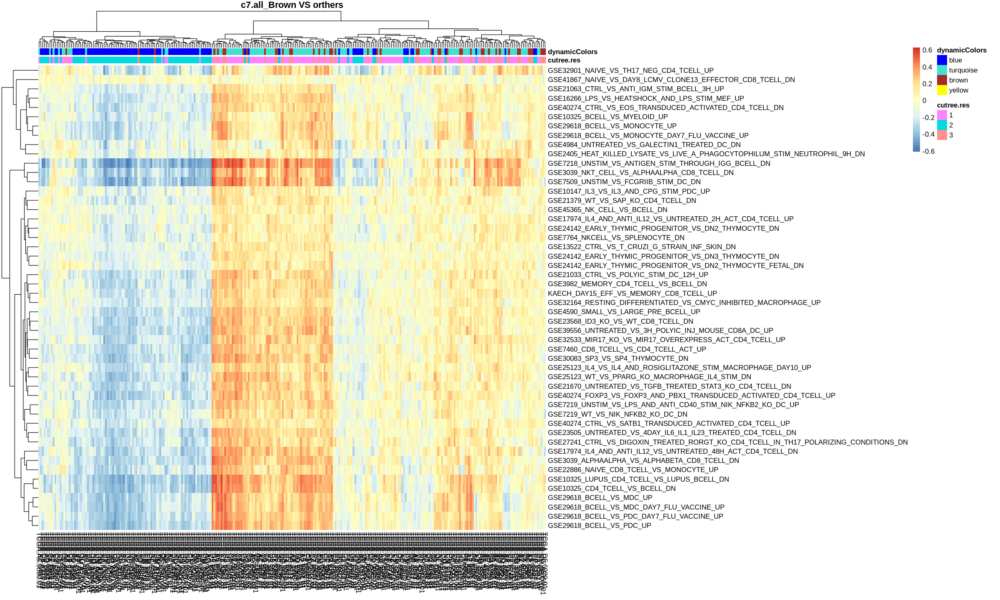

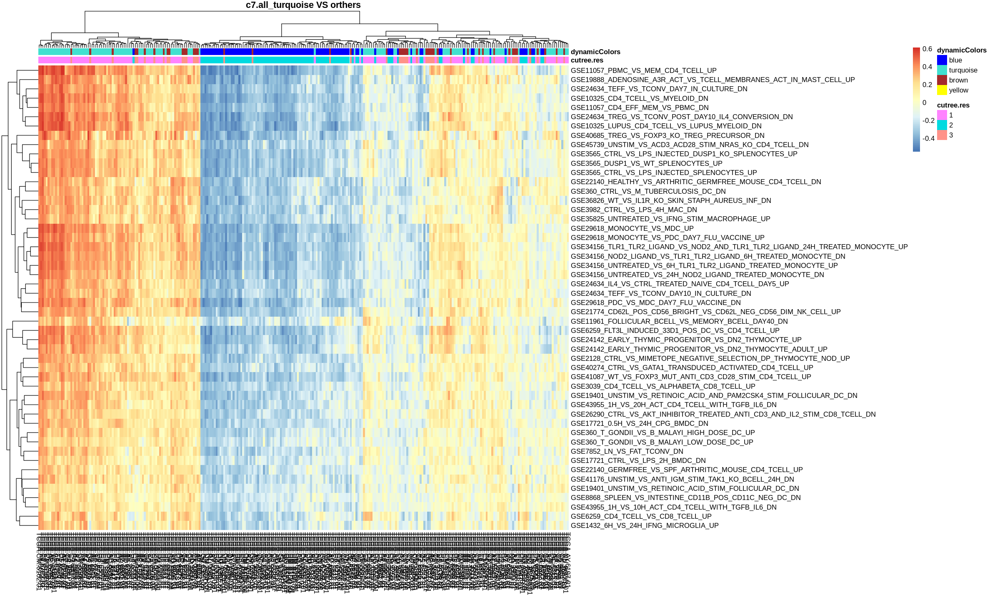

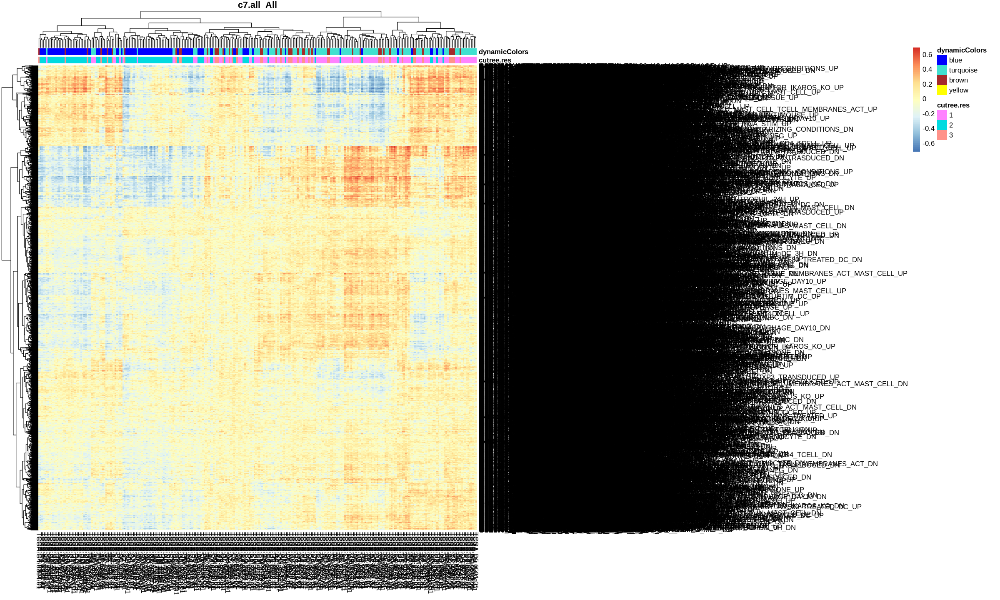

In [14]:
###################### COAD.c7.all.Set #################
## Cut off
library(limma)
fit.c7 <- lmFit(COAD.c7.all.Set, design)
contrast.matrix <- makeContrasts(blue-(brown+turquoise)/2, 
                                 brown-(blue+turquoise)/2,
                                 turquoise-(brown+blue)/2,
                                 levels=design)
fit.c7.2 <- contrasts.fit(fit.c7, contrast.matrix)
fit.c7.2 <- eBayes(fit.c7.2)
plotMD(fit.c7.2)
plotMD(fit.c7.2, column = 2)
plotMD(fit.c7.2, column = 3)
## Find Top significant genesets
## Cut off
adjPvalueCutoff <- 0.01
number = 50
## 
dt <- decideTests(fit.c7.2, p.value = adjPvalueCutoff )
summary(dt)
DEgeneSets.blue.c7 <- topTable(fit.c7.2, coef="blue - (brown + turquoise)/2", number=number,
                               p.value=adjPvalueCutoff,adjust="BH")
DEgeneSets.brown.c7 <- topTable(fit.c7.2, coef="brown - (blue + turquoise)/2", number=number,
                                p.value=adjPvalueCutoff,adjust="BH")
DEgeneSets.turquoise.c7 <- topTable(fit.c7.2, coef="turquoise - (brown + blue)/2", number=number,
                                    p.value=adjPvalueCutoff,adjust="BH")
## Ploting
library(pheatmap)
ann_colors = list(dynamicColors = c(blue = "blue",turquoise = "turquoise", 
                                    brown = "brown", yellow = "yellow"))
#pheatmap::pheatmap(COAD.c7.all.Set,annotation_col = pData(COAD.h.all.Set),
#                   main = "c7.all_all",show_colnames = F)
options(repr.plot.width=20, repr.plot.height=12)
pheatmap::pheatmap(COAD.c7.all.Set[rownames(DEgeneSets.blue.c7),],annotation_col = pData(COAD.c7.all.Set),
                   main = "c7.all_Blue VS orthers",annotation_colors = ann_colors)
pheatmap::pheatmap(COAD.c7.all.Set[rownames(DEgeneSets.brown.c7),],annotation_col = pData(COAD.c7.all.Set),
                   main = "c7.all_Brown VS orthers",annotation_colors = ann_colors)
pheatmap::pheatmap(COAD.c7.all.Set[rownames(DEgeneSets.turquoise.c7),],annotation_col = pData(COAD.c7.all.Set),
                   main = "c7.all_turquoise VS orthers",annotation_colors = ann_colors)
pheatmap::pheatmap(COAD.c7.all.Set,annotation_col = pData(COAD.c7.all.Set),
                   main = "c7.all_All",annotation_colors = ann_colors)

